<a href="https://colab.research.google.com/github/gnganesh99/DKL_on_STM/blob/main/Workflow_DKL_STM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Workflow model for the Deep Kernel Learning implemented on STM.

Refs:

1. Narasimha, Ganesh, et al. "Multiscale structure-property discovery via active learning in scanning tunneling microscopy." arXiv preprint arXiv:2404.07074 (2024).

2. Wilson, Andrew Gordon, et al. "Deep kernel learning." Artificial intelligence and statistics. PMLR, 2016.

3. https://github.com/gnganesh99/DKL_on_STM

# Install and Import packages

In [1]:
! pip install gpax -q
! pip install atomai -q
!pip install sidpy -q

In [19]:
from warnings import filterwarnings

import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
import os

from scipy.signal import find_peaks
from sklearn.model_selection import train_test_split

import gpax
from atomai.utils import get_coord_grid, extract_patches_and_spectra, extract_patches, extract_subimages
import atomai as aoi
import gdown

import cv2
import random



import os
import numpy as np
import h5py
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import sidpy


gpax.utils.enable_x64()

# Functions

In [49]:
def plot_DKL_prediction(obj_mean, obj_var, obj, indices_test, indices_m, y_measured):
    '''
    Plots the objective-mean, variance and the acquisiion function across the sample region
    '''

    fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = (15,5))

    fig.tight_layout(pad = 7)
    next_coord = indices_test[obj.argmax()]
    indices = indices_all
    a = ax[0].scatter(indices[:,1], indices[:,0], c=obj_mean, cmap='viridis', linewidth=5)
    ax[0].scatter(indices_m[:,1], indices_m[:,0], marker='s', c=y_measured, cmap='jet', linewidth=0.2)
    ax[0].scatter(next_coord[1], next_coord[0], marker='x', c='r')
    #ax[0].scatter(X_opt_GP[0, 0], X_opt_GP[0, 1], marker='o', c='r')
    divider = make_axes_locatable(ax[0])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(a, cax=cax, orientation='vertical')
    ax[0].set_title('Objective mean map', fontsize=10, pad = 14)

    ax[0].set_xlabel('X')
    ax[0].set_ylabel('Y')
    #ax[0].axes.xaxis.set_visible(False)
    #ax[0].axes.yaxis.set_visible(False)
    #ax[0].colorbar(a)

    b = ax[1].scatter(indices[:,1], indices[:,0], c=obj_var, cmap='viridis', linewidth=5)
    divider = make_axes_locatable(ax[1])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(b, cax=cax, orientation='vertical')
    ax[1].set_title('Objective variance map', fontsize=10, pad = 14)
    ax[1].set_xlabel('X')
    ax[1].set_ylabel('Y')
    #ax[1].axes.xaxis.set_visible(False)
    #ax[1].axes.yaxis.set_visible(False)
    #ax[1].colorbar(b)


    c= ax[2].scatter(indices_test[:, 1], indices_test[:, 0], c=obj, s = 50)
    ax[2].scatter(next_coord[1], next_coord[0], marker='x', c='k')
    ax[2].set_title("Acquisition function values")
    #divider = make_axes_locatable(ax[2])
    #cax = divider.append_axes('right', size='5%', pad=0.05)

    plt.show()

def normalize_0to1(array):
    '''
    Returns the normalized array in range 0-1
    '''

    array = np.asarray(array)
    norm_array = (array -  np.min(array))/(np.max(array) - np.min(array))
    return norm_array

def positive_current_area(v, i):

    '''
    Returns the integrated current (or didv) for positive bias sweep, V > 0
    '''
    v_s = []
    curr_s = []
    scalar = 0

    for k in range(len(v)):
        if v[k] > 0:
            v_s.append(v[k])
            curr_s.append(i[k])

    scalar += np.trapz(curr_s, x = v_s)

    return scalar

# Import ground truth data

In [50]:
# Download ground truth data
!gdown https://drive.google.com/uc?id=15HaspgtaEY47HGbqE6fJrSazCsuGkt9L


Downloading...
From: https://drive.google.com/uc?id=15HaspgtaEY47HGbqE6fJrSazCsuGkt9L
To: /content/cits_metadata_largearea
100% 33.5M/33.5M [00:00<00:00, 180MB/s]


Measurements conditions

In [51]:
# Sample region is 250 nm x 250 nm; grid points = 180 x 180

x_range = np.linspace(0, 2.5E-7, 180)

#Bias sweep in range : -1.5 to 2.5 V, 121 sweep point
V_range = np.linspace(-1.5, 2.5, 121)

In [52]:
file_name = r"/content/cits_metadata_largearea"
hf = h5py.File(file_name, 'r+')
sidpy.hdf_utils.print_tree(hf)

/
├ Measurement_000
  ---------------
  ├ Current_spectroscopy
    --------------------
    ├ Current_spectroscopy
      --------------------
      ├ Current_spectroscopy
      ├ a
      ├ b
      ├ c
├ Measurement_001
  ---------------
  ├ STM Image
    ---------
    ├ Image
      -----
      ├ Image
      ├ a
      ├ b


## Image data

pixels =  512


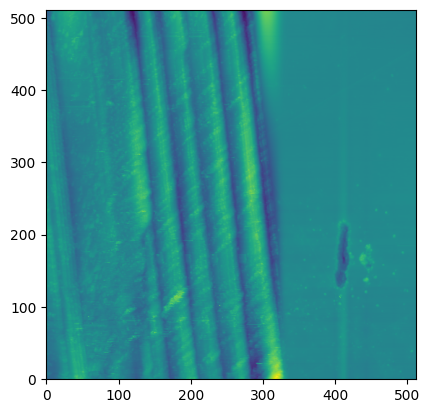

In [53]:
ds_image = hf["Measurement_001/STM Image/Image/Image"]

#Normalize the morphology image in range 0-1
#ds_image =  normalize_0to1(ds_image)

pixels =ds_image.shape[0]
print('pixels = ',pixels)

#Converting to nm
ds_image = np.asarray(ds_image)*1E9
plt.imshow(ds_image, origin='lower')

## CITS ground truth data

In [54]:
dataset = hf["Measurement_000/Current_spectroscopy/Current_spectroscopy/Current_spectroscopy"]
dataset = np.asarray(dataset)

print('contains current-volatge spectrotroscopy dataset of size:',dataset.shape)

contains current-volatge spectrotroscopy dataset of size: (180, 180, 121)


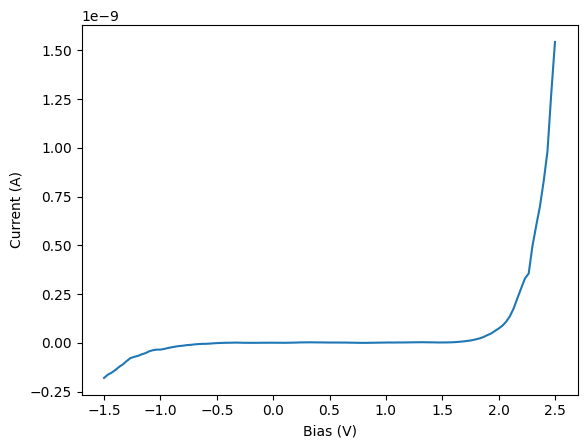

In [55]:
point_index = [10, 10]

#current spectroscopy at point_index:
i = dataset[point_index[0], point_index[1]]

plt.plot(V_range, i)
plt.xlabel('Bias (V)')
plt.ylabel('Current (A)')
plt.show()

## Scalarizer

Here we introduce the scalarizer as the integration of the I-V spectrum for V>0.
This is given by the function "positive_current_area"

<ipython-input-49-afff0c552075>:69: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  scalar += np.trapz(curr_s, x = v_s)


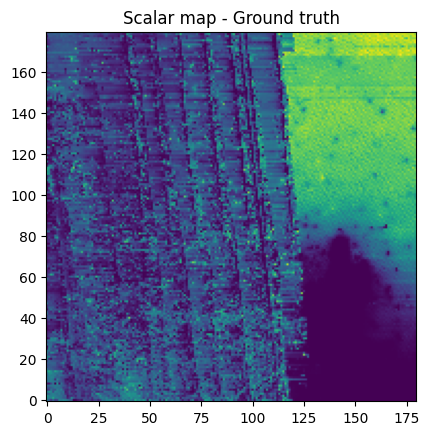

In [56]:
#scalarized dataset
scalar_ds = np.zeros([dataset.shape[0], dataset.shape[1]])

for i in range(dataset.shape[0]):
  for j in range(dataset.shape[1]):

    current_spectrum  = dataset[i, j, :]
    scalar = positive_current_area(V_range, current_spectrum)
    scalar_ds[i, j] = scalar

plt.imshow(scalar_ds, origin = 'lower')
plt.title("Scalar map - Ground truth")
plt.show()


In [57]:
hf.close()

# Images for training

features shape =  (2304, 30, 30)
Patch coordinates =  (2304, 2)
Image is fragmented to multiple pathches.
Coordinate at grid index 0 = [20. 20.]
Patch at index 0:



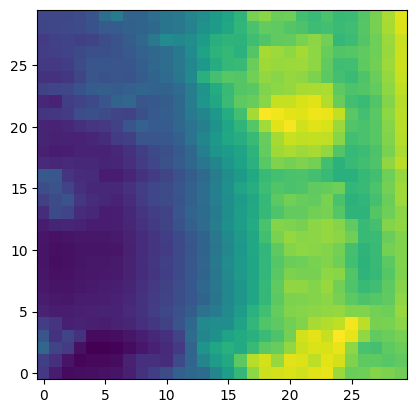

In [58]:
# Window_size is the width (in pixels) of the patch considered as a feature-example for training
window_size = 30

# Coordinate step is the distance between the center of two adjacent image patches
coordinate_step = 10


coords = get_coord_grid(ds_image, step = coordinate_step, return_dict= False)
indices_all = coords
#print('initial coordinates = ',coords[:, 0].shape)


# Extract patches (or features) and the center coordinates of each patch.
extracted_features = extract_subimages(ds_image, coordinates = coords, window_size = window_size)
patches, coordinates, _ = extracted_features
patches = patches.squeeze()



print('features shape = ',patches.shape)
print('Patch coordinates = ',coordinates.shape)

grid_index = 0
print(f"Image is fragmented to multiple pathches.\nCoordinate at grid index {grid_index} = {coordinates[grid_index]}\nPatch at index {grid_index}:\n")

plt.imshow(patches[grid_index], origin = 'lower')
plt.show()

Prepare train and test sets

In [59]:
# Reshape patches into 1D vectors
n, d1, d2 = patches.shape
X = patches.reshape(n, d1*d2)

# Reshape ground-truth scalars for one-to-one correlation with the image patches
scalar_dim = int(n**0.5)
data_spec = cv2.resize(scalar_ds,(scalar_dim, scalar_dim))

y = np.reshape(data_spec, (n))
indices_all = coordinates
X.shape, y.shape


((2304, 900), (2304,))

# DKL Implementation - Active learning

Create X_train and y_train which are our measured image patches (from STM topography) and scalars derived from tunneling spectroscopy, respectively.
The indices_train are grid coordinates of the measured points

X_test and y_test are the "unkwown" ones.
The indices_test are the grid coordinates of the remaining available points on the grid

In [60]:
# Test train split
train_size = 0.1       # 0.1 implies 10 % of data for model training

(X_train, X_test, y_train, y_test, indices_train, indices_test) =  train_test_split(X, y, indices_all, train_size = train_size, shuffle=True, random_state=3)

In [61]:
y_train.shape

(230,)

Plot train set

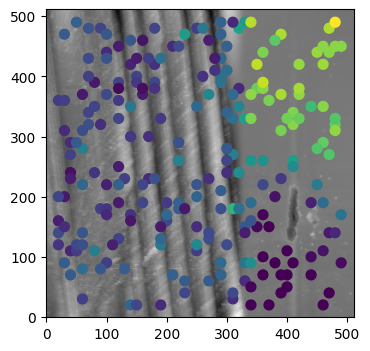

In [62]:
plt.figure(figsize=(4, 4))
plt.imshow(ds_image, origin ='lower', cmap = 'gray')
plt.scatter(indices_train[:, 1], indices_train[:, 0], s=50, c=y_train)
initial_train = len(y_train)

## Active learning based exploration

1/100


100%|██████████| 100/100 [00:08<00:00, 12.22it/s, init loss: 60354.3088, avg. loss [96-100]: 57038.4697]



Inferred GP kernel parameters
k_length         [5.805  3.7402]
k_scale          0.19390000000000002
noise            0.046


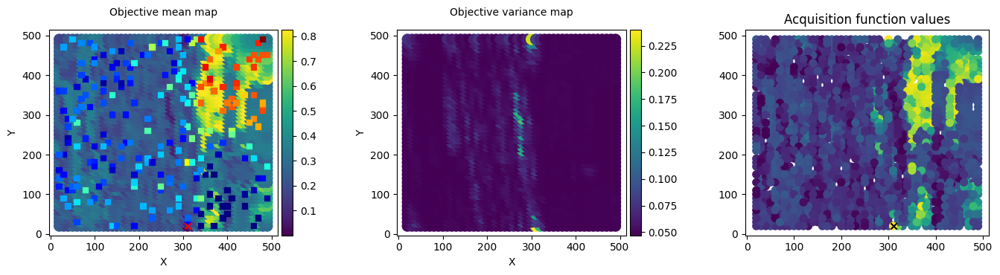

2/100


100%|██████████| 100/100 [00:07<00:00, 13.15it/s, init loss: 60355.6467, avg. loss [96-100]: 56981.1444]



Inferred GP kernel parameters
k_length         [4.5291 6.7482]
k_scale          0.16060000000000002
noise            0.043300000000000005


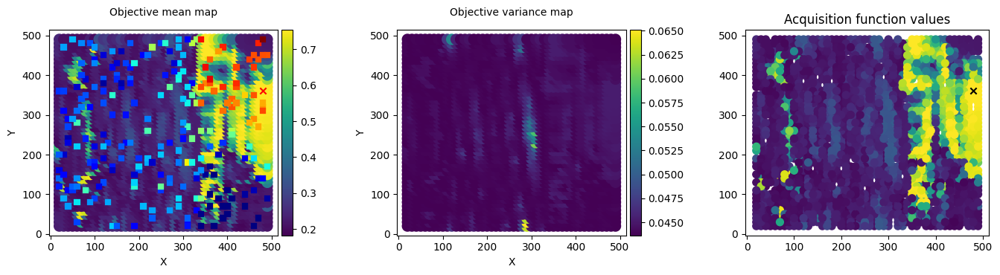

3/100


100%|██████████| 100/100 [00:07<00:00, 12.57it/s, init loss: 60356.7560, avg. loss [96-100]: 56997.9998]



Inferred GP kernel parameters
k_length         [3.062  3.2639]
k_scale          0.19260000000000002
noise            0.039900000000000005


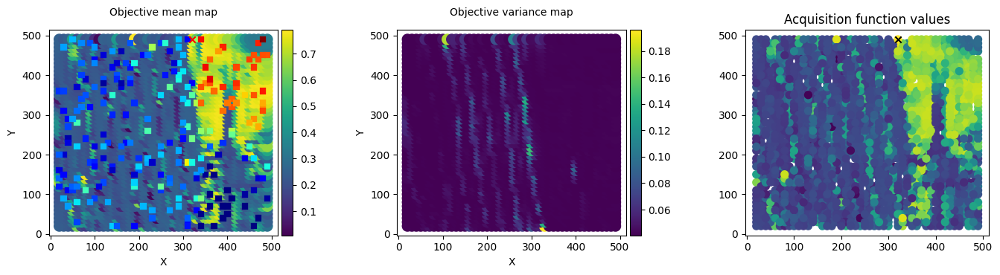

4/100


100%|██████████| 100/100 [00:06<00:00, 14.82it/s, init loss: 60358.1440, avg. loss [96-100]: 57018.0903]



Inferred GP kernel parameters
k_length         [2.7393 3.2027]
k_scale          0.2187
noise            0.0438


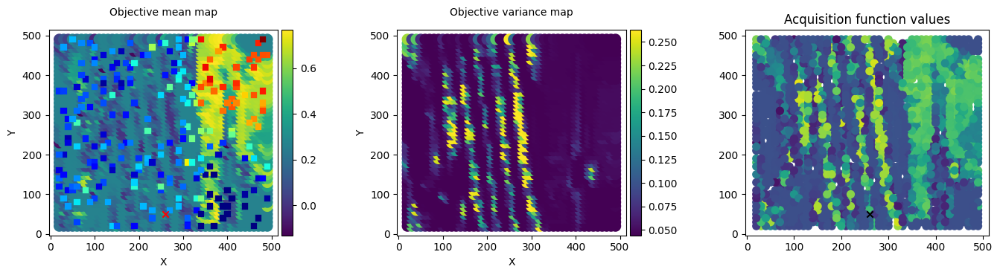

5/100


100%|██████████| 100/100 [00:05<00:00, 18.51it/s, init loss: 60359.4932, avg. loss [96-100]: 57004.9883]



Inferred GP kernel parameters
k_length         [2.1261 2.6672]
k_scale          0.24080000000000001
noise            0.0378


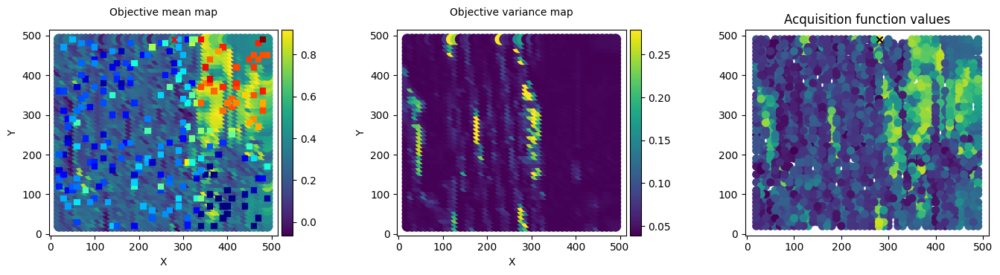

6/100


100%|██████████| 100/100 [00:07<00:00, 12.79it/s, init loss: 60360.8489, avg. loss [96-100]: 56998.0142]



Inferred GP kernel parameters
k_length         [5.88   3.6911]
k_scale          0.1761
noise            0.041800000000000004


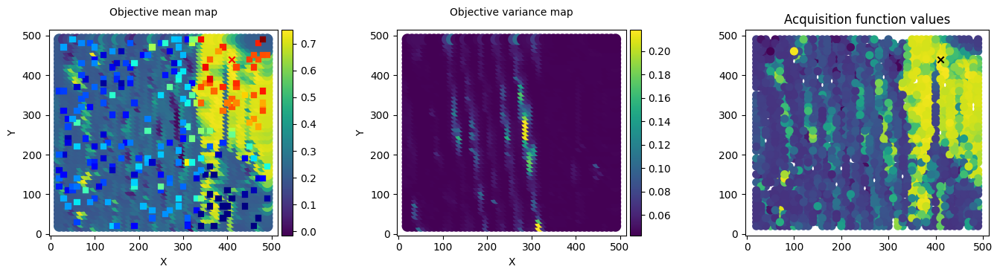

7/100


100%|██████████| 100/100 [00:09<00:00, 11.00it/s, init loss: 60361.9944, avg. loss [96-100]: 57009.9549]



Inferred GP kernel parameters
k_length         [5.0983 5.4218]
k_scale          0.14930000000000002
noise            0.044000000000000004


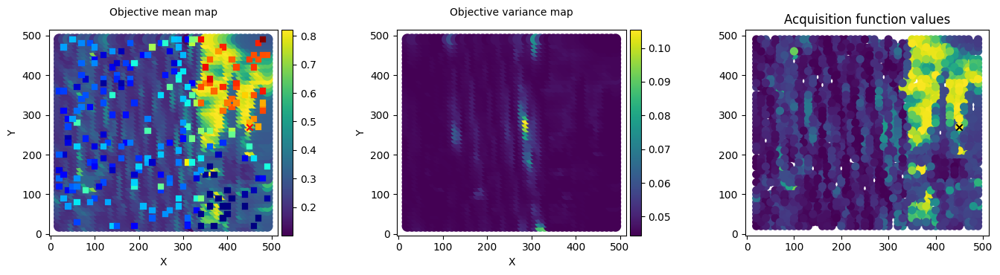

8/100


100%|██████████| 100/100 [00:09<00:00, 10.39it/s, init loss: 60363.1007, avg. loss [96-100]: 56979.7020]



Inferred GP kernel parameters
k_length         [3.7958 5.8783]
k_scale          0.1405
noise            0.0397


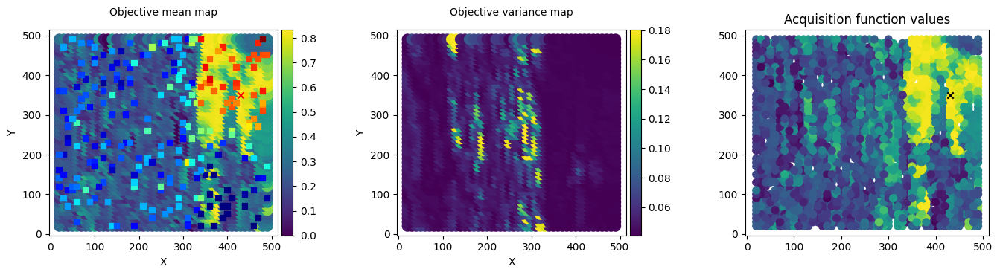

9/100


100%|██████████| 100/100 [00:08<00:00, 12.34it/s, init loss: 60364.2471, avg. loss [96-100]: 56958.9544]



Inferred GP kernel parameters
k_length         [4.1426 2.9991]
k_scale          0.2087
noise            0.037200000000000004


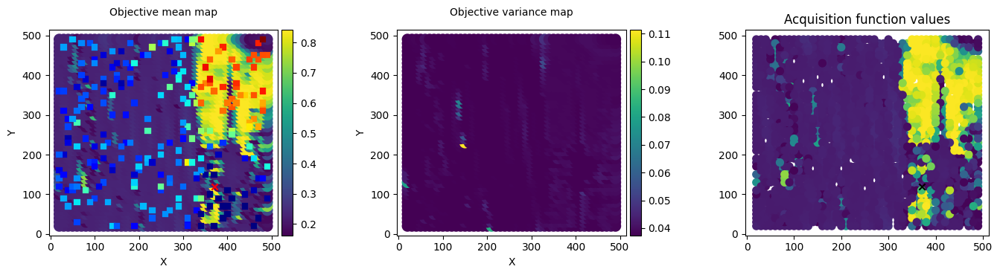

10/100


100%|██████████| 100/100 [00:06<00:00, 16.16it/s, init loss: 60365.5126, avg. loss [96-100]: 56976.3210]



Inferred GP kernel parameters
k_length         [6.2659 4.7421]
k_scale          0.1577
noise            0.0371


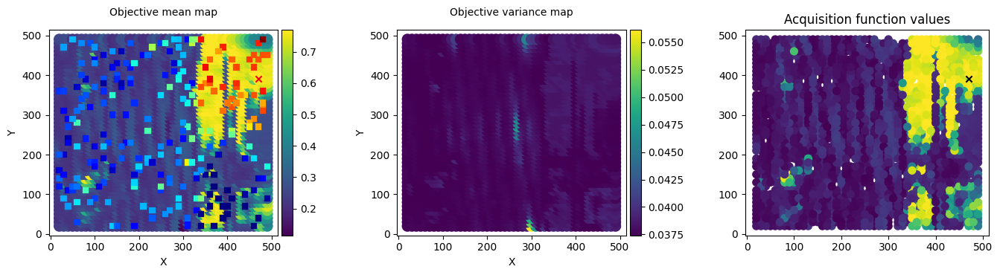

11/100


100%|██████████| 100/100 [00:08<00:00, 11.16it/s, init loss: 60366.6995, avg. loss [96-100]: 56996.7287]



Inferred GP kernel parameters
k_length         [3.5532 4.1742]
k_scale          0.2099
noise            0.040100000000000004


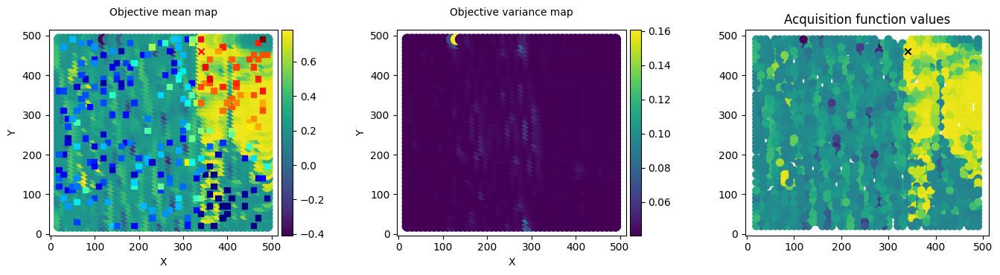

12/100


100%|██████████| 100/100 [00:09<00:00, 10.90it/s, init loss: 60367.8992, avg. loss [96-100]: 57057.8851]



Inferred GP kernel parameters
k_length         [4.1234 6.6889]
k_scale          0.1877
noise            0.042


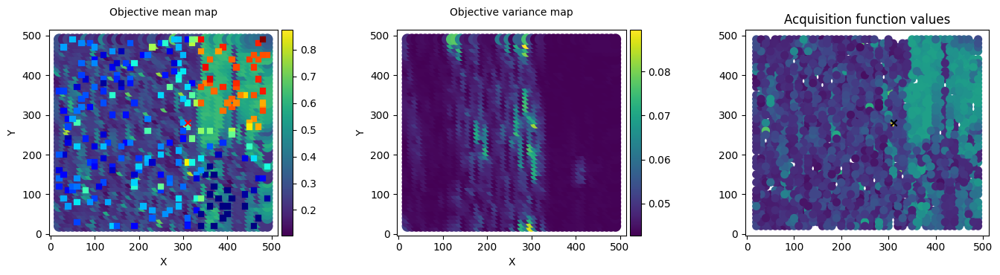

13/100


100%|██████████| 100/100 [00:10<00:00,  9.21it/s, init loss: 60369.2503, avg. loss [96-100]: 57006.1403]



Inferred GP kernel parameters
k_length         [5.4635 5.4556]
k_scale          0.1751
noise            0.0434


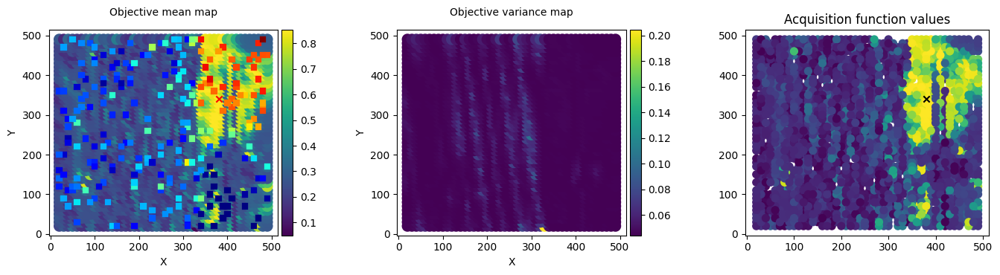

14/100


100%|██████████| 100/100 [00:06<00:00, 15.48it/s, init loss: 60370.3665, avg. loss [96-100]: 57014.0056]



Inferred GP kernel parameters
k_length         [3.9035 3.3922]
k_scale          0.1626
noise            0.0432


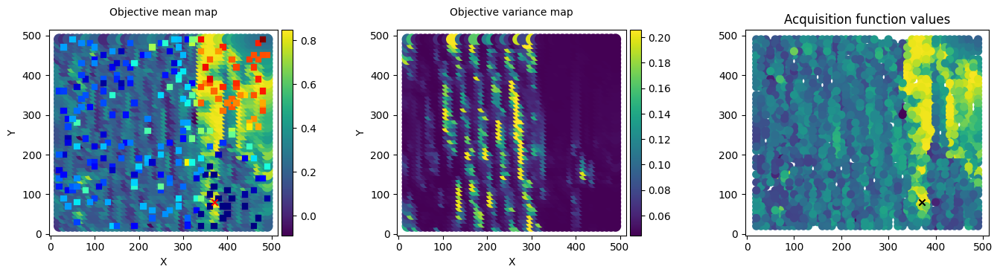

15/100


100%|██████████| 100/100 [00:10<00:00,  9.75it/s, init loss: 60371.6601, avg. loss [96-100]: 57014.6477]



Inferred GP kernel parameters
k_length         [5.4152 4.0056]
k_scale          0.08080000000000001
noise            0.0424


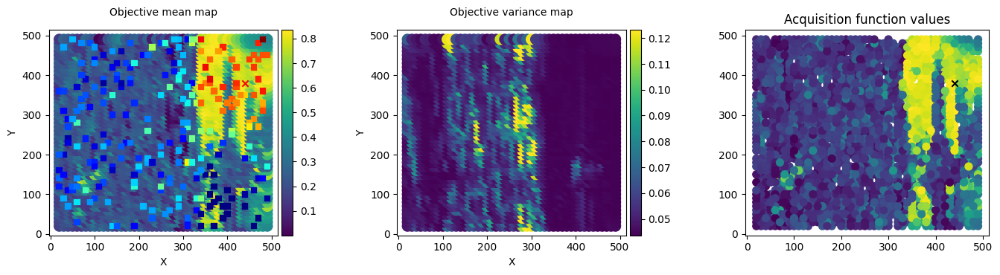

16/100


100%|██████████| 100/100 [00:08<00:00, 12.34it/s, init loss: 60372.7730, avg. loss [96-100]: 57045.6462]



Inferred GP kernel parameters
k_length         [4.4932 2.9438]
k_scale          0.2056
noise            0.0443


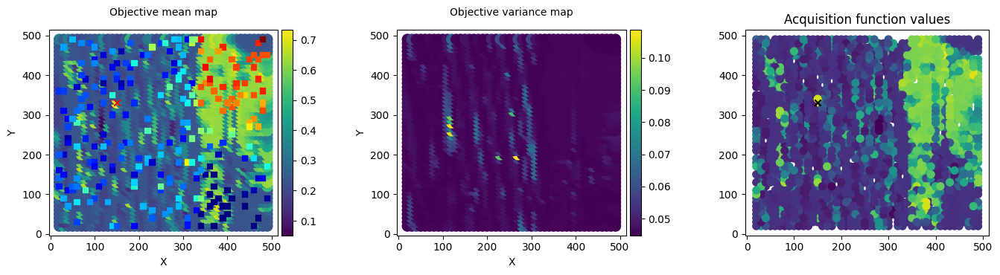

17/100


100%|██████████| 100/100 [00:07<00:00, 13.46it/s, init loss: 60374.0949, avg. loss [96-100]: 56964.2686]



Inferred GP kernel parameters
k_length         [4.076  5.4768]
k_scale          0.1786
noise            0.037700000000000004


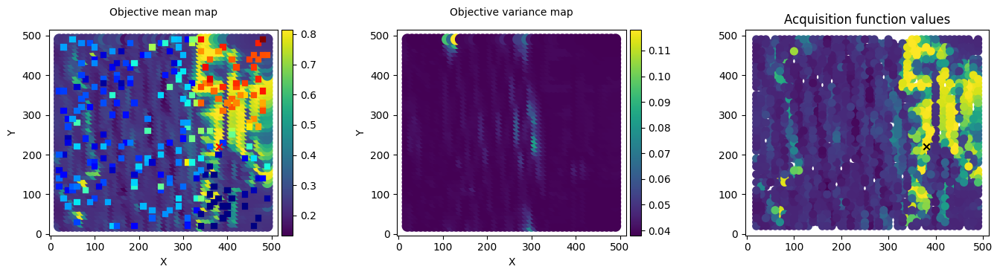

18/100


100%|██████████| 100/100 [00:10<00:00,  9.69it/s, init loss: 60375.3882, avg. loss [96-100]: 57077.3042]



Inferred GP kernel parameters
k_length         [5.1802 9.487 ]
k_scale          0.12510000000000002
noise            0.0454


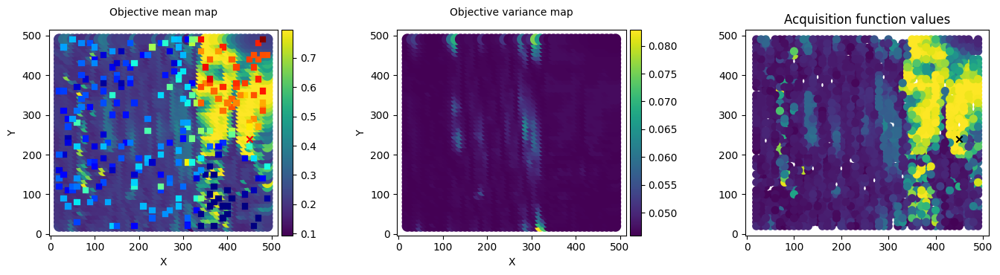

19/100


100%|██████████| 100/100 [00:14<00:00,  6.95it/s, init loss: 60376.5510, avg. loss [96-100]: 56980.4734]



Inferred GP kernel parameters
k_length         [8.4955 4.2481]
k_scale          0.1226
noise            0.0375


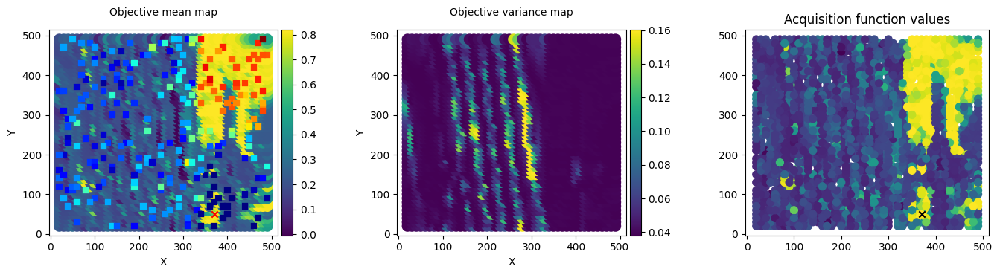

20/100


100%|██████████| 100/100 [00:08<00:00, 11.34it/s, init loss: 60377.8361, avg. loss [96-100]: 56955.6418]



Inferred GP kernel parameters
k_length         [3.7514 6.2248]
k_scale          0.1612
noise            0.039400000000000004


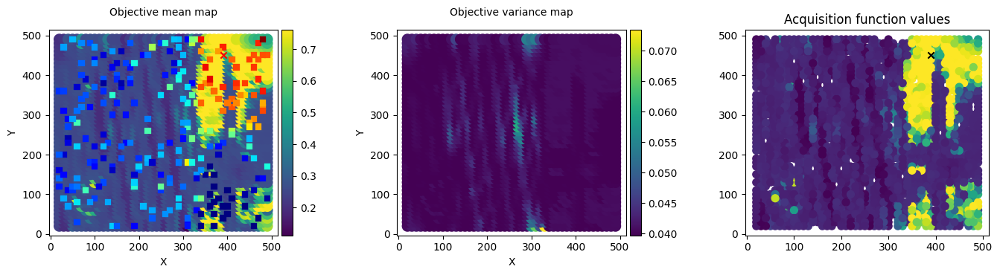

21/100


100%|██████████| 100/100 [00:10<00:00,  9.13it/s, init loss: 60378.9395, avg. loss [96-100]: 56974.4107]



Inferred GP kernel parameters
k_length         [3.8387 2.4072]
k_scale          0.22870000000000001
noise            0.040600000000000004


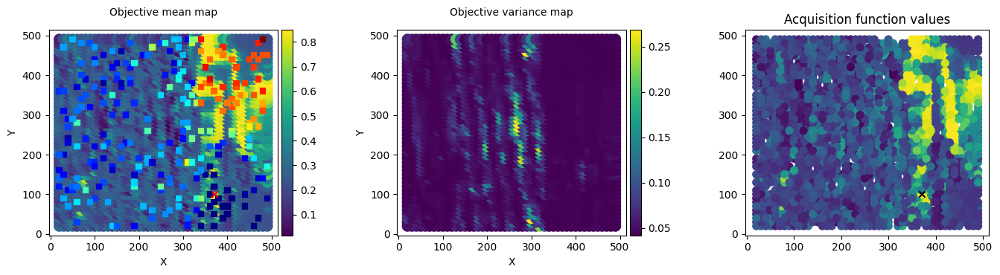

22/100


100%|██████████| 100/100 [00:09<00:00, 10.48it/s, init loss: 60380.2389, avg. loss [96-100]: 57031.1210]



Inferred GP kernel parameters
k_length         [7.507  5.9036]
k_scale          0.1618
noise            0.0405


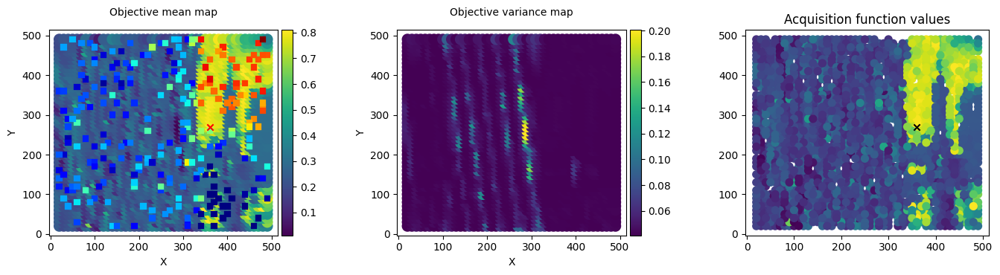

23/100


100%|██████████| 100/100 [00:11<00:00,  8.34it/s, init loss: 60381.3994, avg. loss [96-100]: 56975.2696]



Inferred GP kernel parameters
k_length         [3.1206 3.7818]
k_scale          0.2197
noise            0.038400000000000004


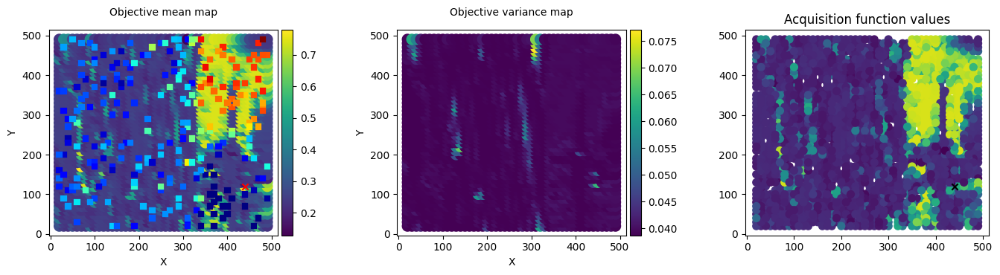

24/100


100%|██████████| 100/100 [00:09<00:00, 10.14it/s, init loss: 60382.6554, avg. loss [96-100]: 56980.2268]



Inferred GP kernel parameters
k_length         [6.6662 3.7016]
k_scale          0.1917
noise            0.0429


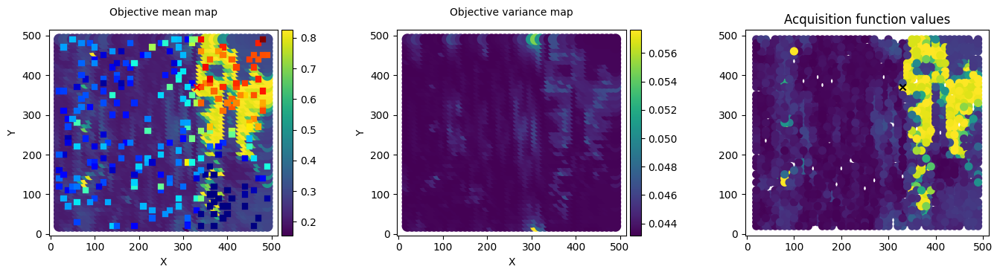

25/100


100%|██████████| 100/100 [00:08<00:00, 11.47it/s, init loss: 60383.8593, avg. loss [96-100]: 57035.7232]



Inferred GP kernel parameters
k_length         [6.4999 4.4912]
k_scale          0.14350000000000002
noise            0.0432


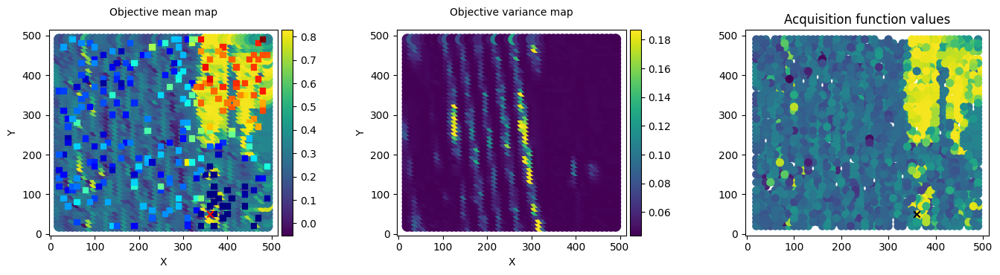

26/100


100%|██████████| 100/100 [00:08<00:00, 11.15it/s, init loss: 60385.0879, avg. loss [96-100]: 57072.2601]



Inferred GP kernel parameters
k_length         [5.7207 3.1531]
k_scale          0.1771
noise            0.0441


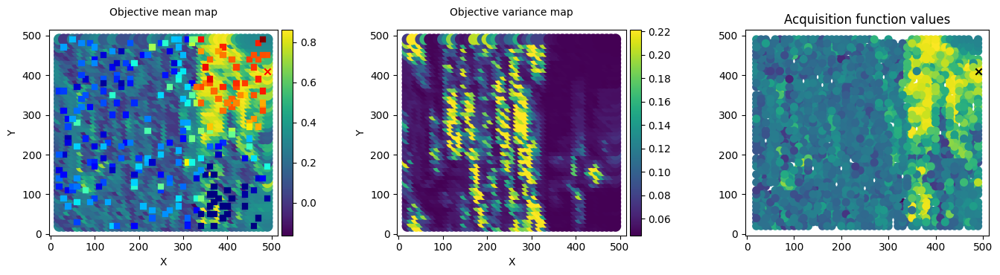

27/100


100%|██████████| 100/100 [00:11<00:00,  8.74it/s, init loss: 60386.1872, avg. loss [96-100]: 56969.8987]



Inferred GP kernel parameters
k_length         [3.2753 3.4512]
k_scale          0.1517
noise            0.0379


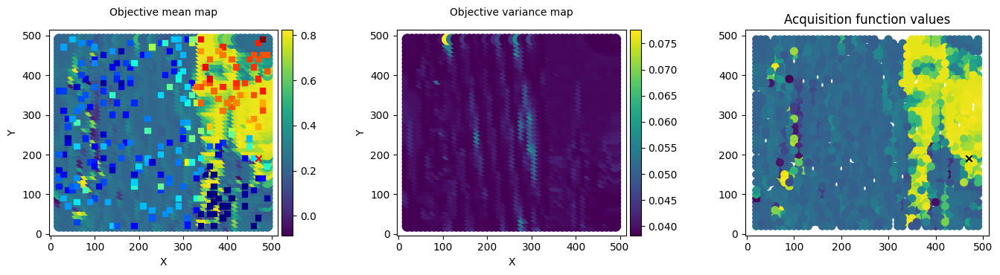

28/100


100%|██████████| 100/100 [00:11<00:00,  8.92it/s, init loss: 60387.3932, avg. loss [96-100]: 57023.9201]



Inferred GP kernel parameters
k_length         [3.7662 4.0779]
k_scale          0.17420000000000002
noise            0.0478


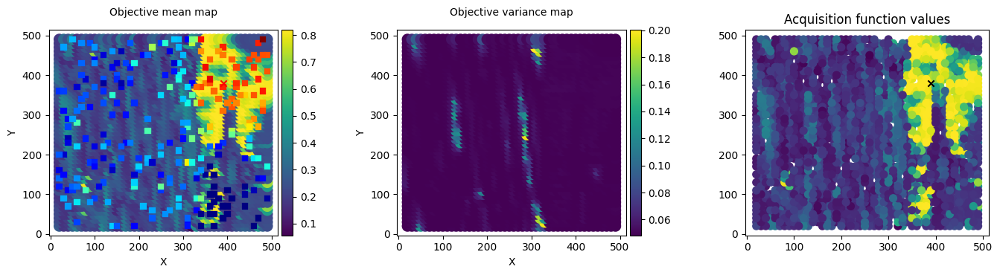

29/100


100%|██████████| 100/100 [00:13<00:00,  7.39it/s, init loss: 60388.4987, avg. loss [96-100]: 56982.3802]



Inferred GP kernel parameters
k_length         [2.8577 4.1842]
k_scale          0.1918
noise            0.037200000000000004


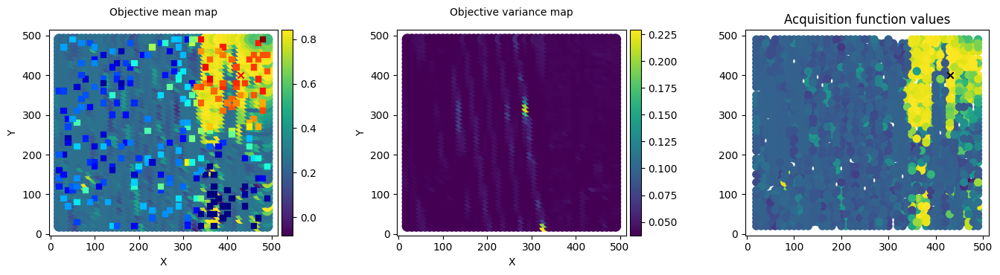

30/100


100%|██████████| 100/100 [00:13<00:00,  7.27it/s, init loss: 60389.5973, avg. loss [96-100]: 57006.9342]



Inferred GP kernel parameters
k_length         [2.9732 7.0812]
k_scale          0.16840000000000002
noise            0.042300000000000004


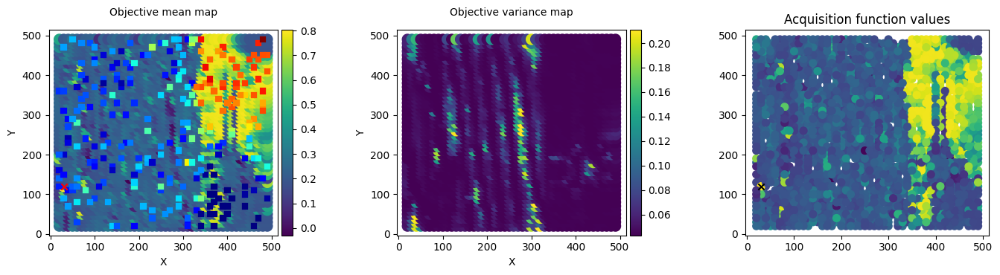

31/100


100%|██████████| 100/100 [00:17<00:00,  5.69it/s, init loss: 60390.9328, avg. loss [96-100]: 57091.3980]



Inferred GP kernel parameters
k_length         [4.9162 7.7543]
k_scale          0.1419
noise            0.043000000000000003


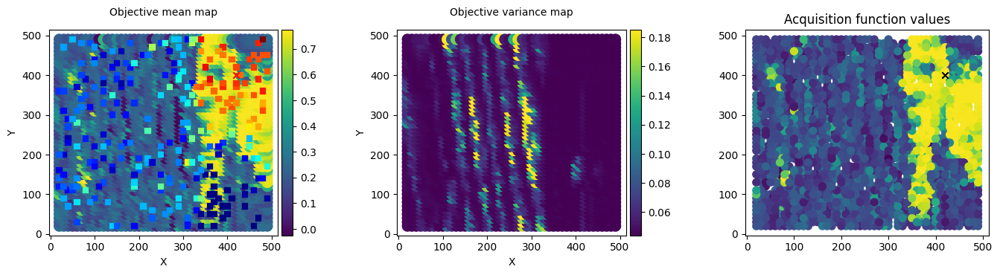

32/100


100%|██████████| 100/100 [00:11<00:00,  8.92it/s, init loss: 60392.0350, avg. loss [96-100]: 57004.0762]



Inferred GP kernel parameters
k_length         [2.637  2.8791]
k_scale          0.1923
noise            0.0397


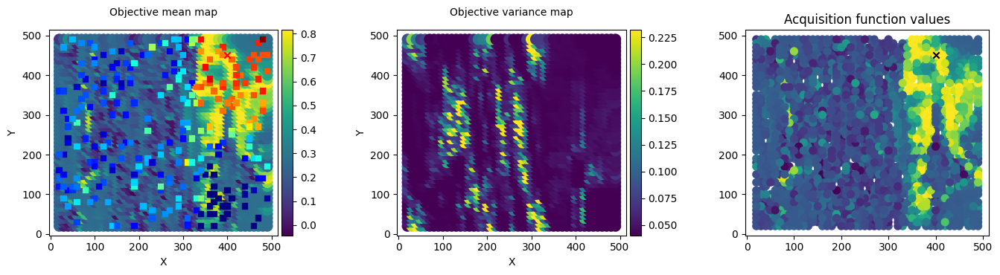

33/100


100%|██████████| 100/100 [00:10<00:00,  9.82it/s, init loss: 60393.2060, avg. loss [96-100]: 56965.1776]



Inferred GP kernel parameters
k_length         [3.0095 4.7835]
k_scale          0.2044
noise            0.038200000000000005


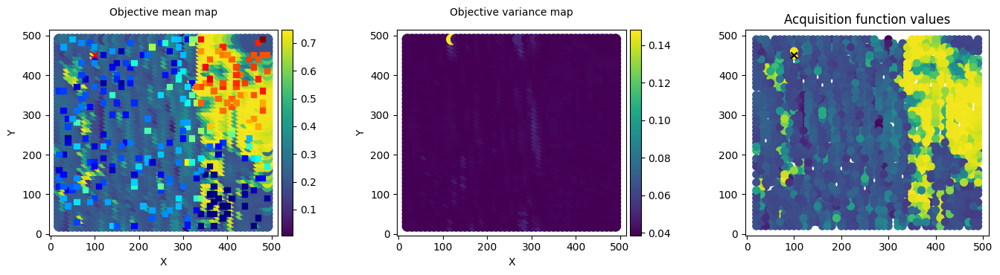

34/100


100%|██████████| 100/100 [00:12<00:00,  8.06it/s, init loss: 60394.4715, avg. loss [96-100]: 57045.6159]



Inferred GP kernel parameters
k_length         [1.9517 2.306 ]
k_scale          0.23970000000000002
noise            0.0388


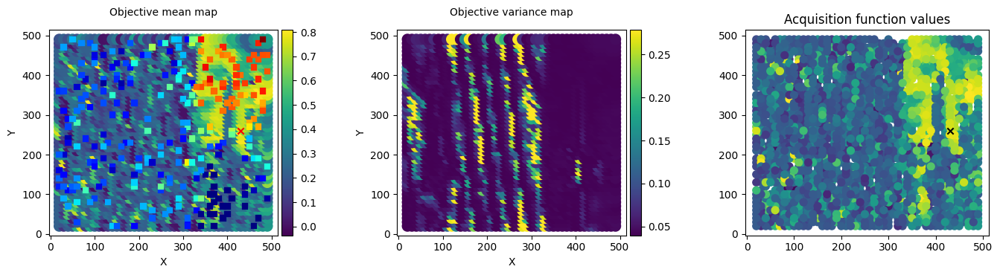

35/100


100%|██████████| 100/100 [00:12<00:00,  7.73it/s, init loss: 60395.8043, avg. loss [96-100]: 56972.8484]



Inferred GP kernel parameters
k_length         [5.3138 3.1085]
k_scale          0.2026
noise            0.0413


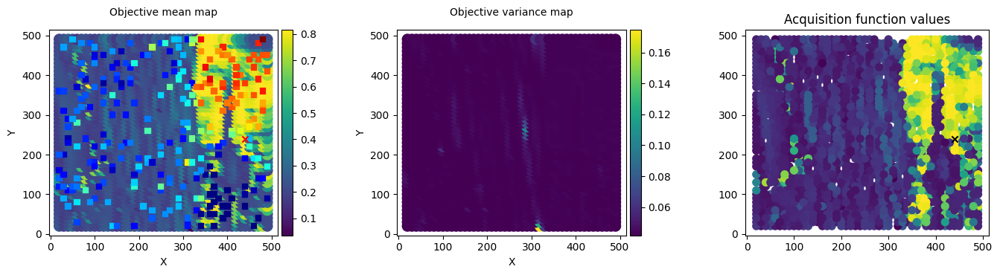

36/100


100%|██████████| 100/100 [00:19<00:00,  5.24it/s, init loss: 60396.9343, avg. loss [96-100]: 56964.1916]



Inferred GP kernel parameters
k_length         [3.3049 4.0633]
k_scale          0.16390000000000002
noise            0.0363


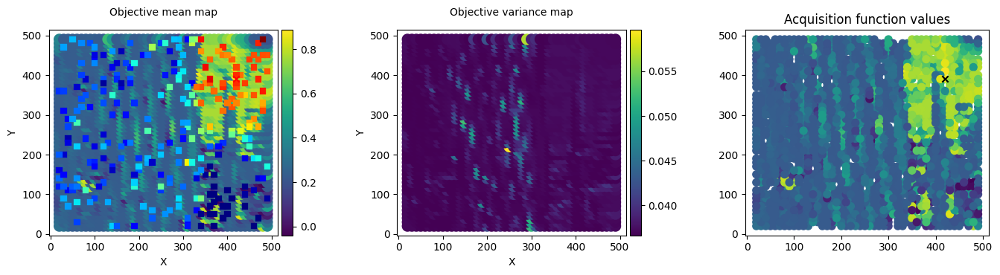

37/100


100%|██████████| 100/100 [00:14<00:00,  7.06it/s, init loss: 60398.0299, avg. loss [96-100]: 57076.1151]



Inferred GP kernel parameters
k_length         [4.9715 6.9801]
k_scale          0.12040000000000001
noise            0.0446


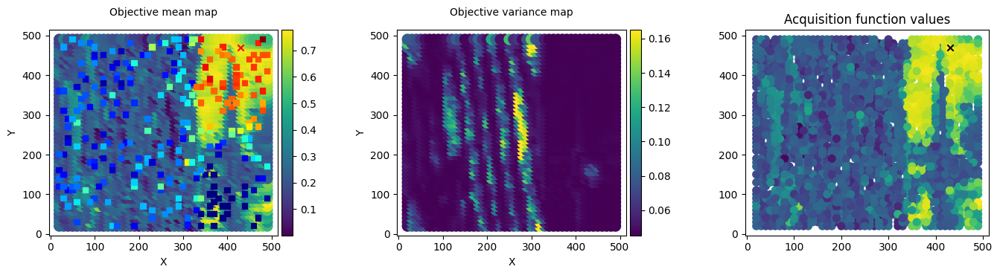

38/100


100%|██████████| 100/100 [00:17<00:00,  5.87it/s, init loss: 60399.0562, avg. loss [96-100]: 57073.4495]



Inferred GP kernel parameters
k_length         [7.328  5.5281]
k_scale          0.1272
noise            0.0429


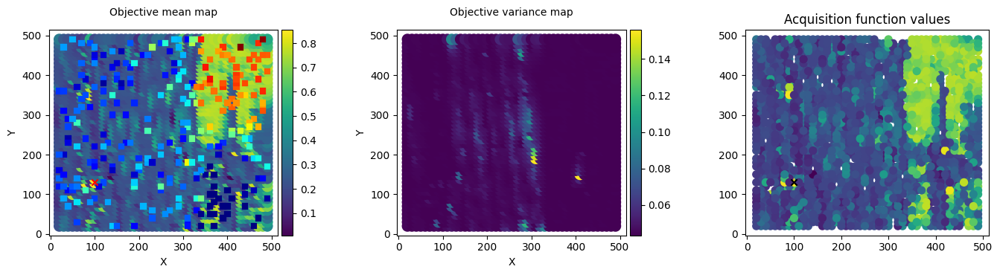

39/100


100%|██████████| 100/100 [00:17<00:00,  5.80it/s, init loss: 60400.3461, avg. loss [96-100]: 57069.3538]



Inferred GP kernel parameters
k_length         [8.3685 3.8321]
k_scale          0.09090000000000001
noise            0.0442


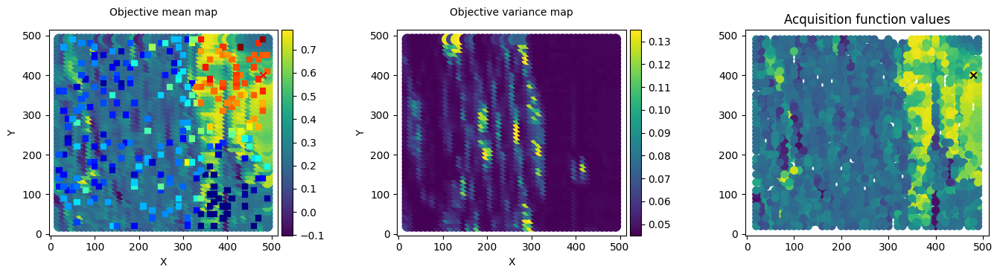

40/100


100%|██████████| 100/100 [00:18<00:00,  5.40it/s, init loss: 60401.4559, avg. loss [96-100]: 56995.4125]



Inferred GP kernel parameters
k_length         [2.7273 2.5785]
k_scale          0.224
noise            0.037000000000000005


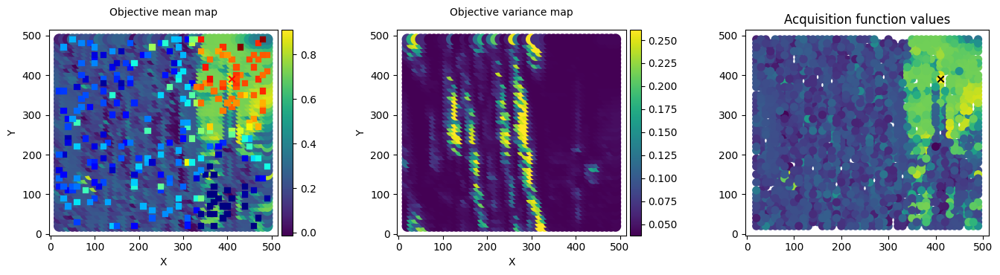

41/100


100%|██████████| 100/100 [00:20<00:00,  4.82it/s, init loss: 60402.6384, avg. loss [96-100]: 56986.9916]



Inferred GP kernel parameters
k_length         [4.7602 4.2159]
k_scale          0.1867
noise            0.037000000000000005


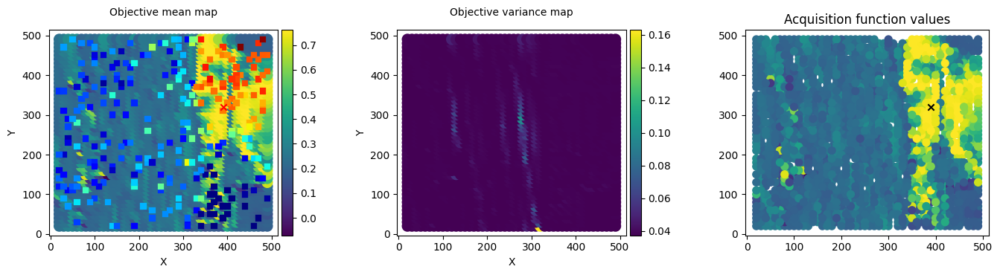

42/100


100%|██████████| 100/100 [00:24<00:00,  4.15it/s, init loss: 60403.7599, avg. loss [96-100]: 56977.6088]



Inferred GP kernel parameters
k_length         [3.9587 3.251 ]
k_scale          0.1844
noise            0.0375


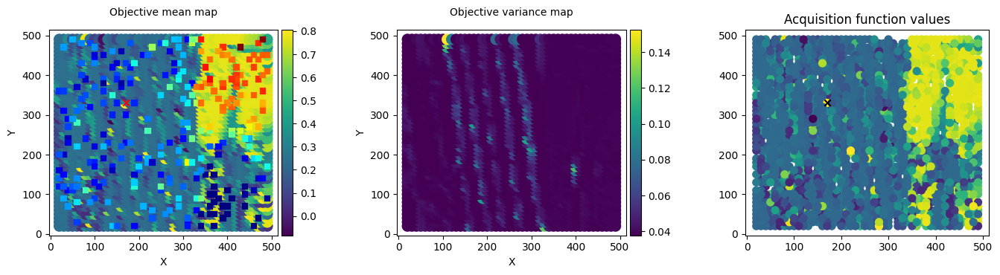

43/100


100%|██████████| 100/100 [00:21<00:00,  4.62it/s, init loss: 60405.0947, avg. loss [96-100]: 57059.8399]



Inferred GP kernel parameters
k_length         [4.9596 3.3727]
k_scale          0.1781
noise            0.0383


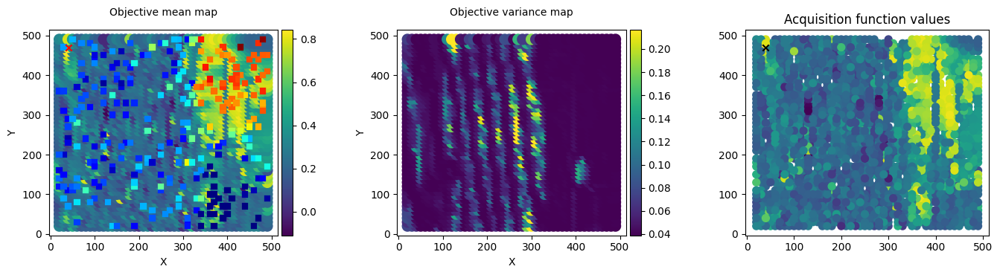

44/100


100%|██████████| 100/100 [00:15<00:00,  6.53it/s, init loss: 60406.4447, avg. loss [96-100]: 57019.5603]



Inferred GP kernel parameters
k_length         [5.0646 4.0155]
k_scale          0.1847
noise            0.038200000000000005


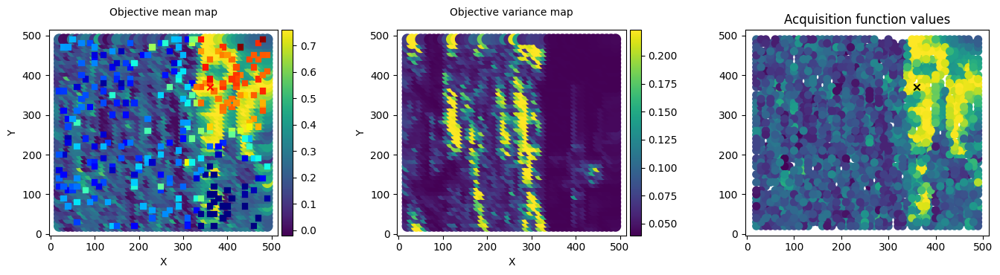

45/100


100%|██████████| 100/100 [00:21<00:00,  4.67it/s, init loss: 60407.5558, avg. loss [96-100]: 57081.6957]



Inferred GP kernel parameters
k_length         [4.7762 6.3753]
k_scale          0.1522
noise            0.045200000000000004


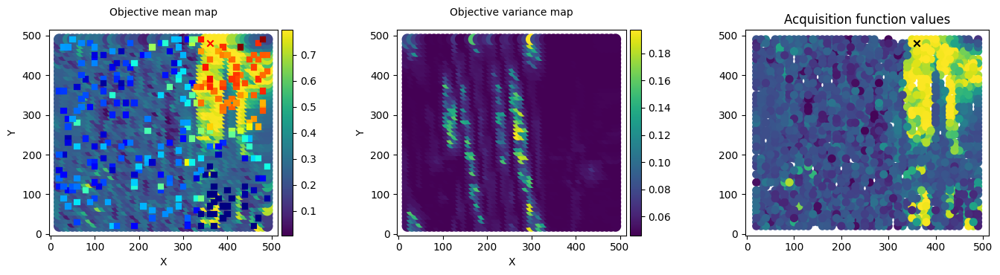

46/100


100%|██████████| 100/100 [00:20<00:00,  4.85it/s, init loss: 60408.6513, avg. loss [96-100]: 57026.8474]



Inferred GP kernel parameters
k_length         [7.2141 3.8549]
k_scale          0.1129
noise            0.0405


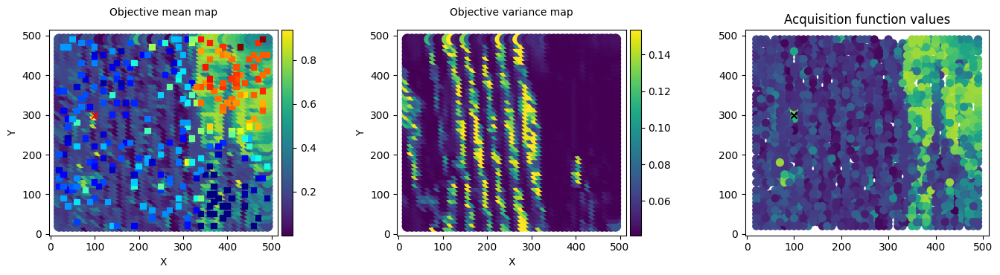

47/100


100%|██████████| 100/100 [00:22<00:00,  4.35it/s, init loss: 60409.9687, avg. loss [96-100]: 57026.2842]



Inferred GP kernel parameters
k_length         [4.5052 3.5208]
k_scale          0.1608
noise            0.0344


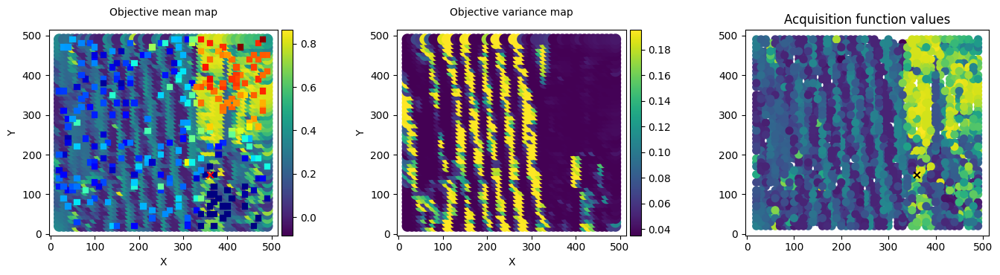

48/100


100%|██████████| 100/100 [00:11<00:00,  9.05it/s, init loss: 60411.1304, avg. loss [96-100]: 57028.3210]



Inferred GP kernel parameters
k_length         [2.8269 3.1458]
k_scale          0.135
noise            0.0398


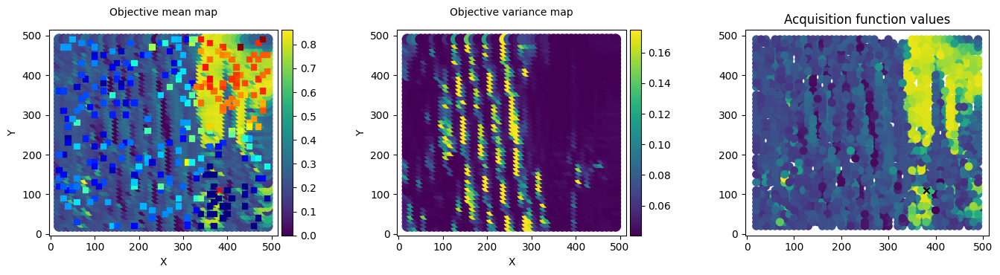

49/100


100%|██████████| 100/100 [00:18<00:00,  5.48it/s, init loss: 60412.3234, avg. loss [96-100]: 57011.2449]



Inferred GP kernel parameters
k_length         [6.1908 4.4448]
k_scale          0.1433
noise            0.0374


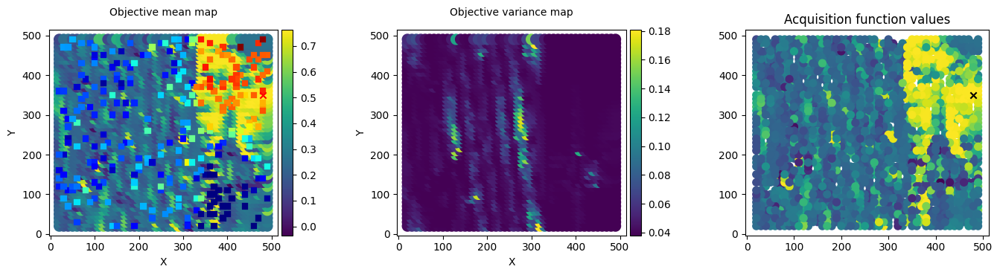

50/100


100%|██████████| 100/100 [00:18<00:00,  5.54it/s, init loss: 60413.4296, avg. loss [96-100]: 56956.7489]



Inferred GP kernel parameters
k_length         [3.8227 2.1629]
k_scale          0.2146
noise            0.0346


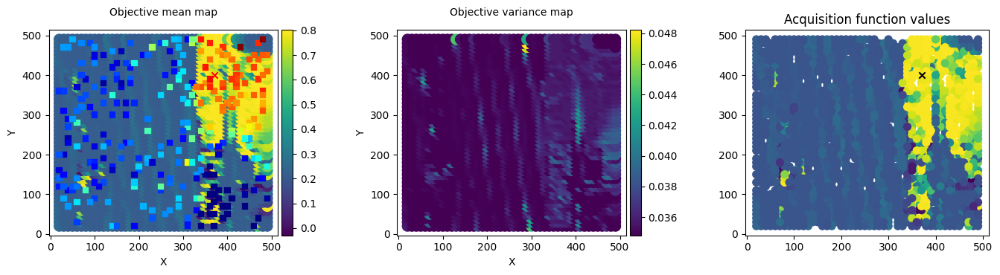

51/100


100%|██████████| 100/100 [00:16<00:00,  5.90it/s, init loss: 60414.5345, avg. loss [96-100]: 57012.0091]



Inferred GP kernel parameters
k_length         [3.7321 3.0141]
k_scale          0.1842
noise            0.037200000000000004


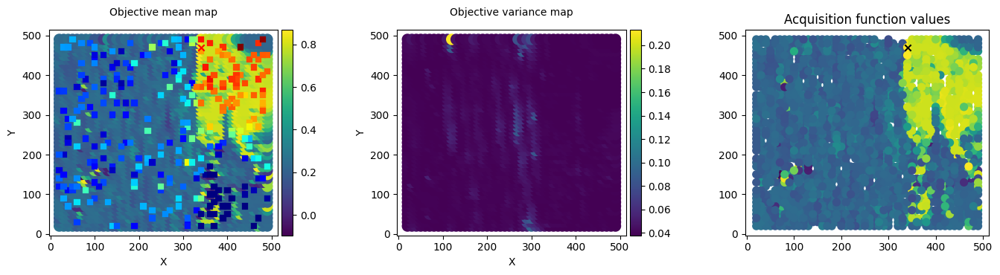

52/100


100%|██████████| 100/100 [00:13<00:00,  7.31it/s, init loss: 60415.8126, avg. loss [96-100]: 57036.3807]



Inferred GP kernel parameters
k_length         [3.9229 7.9719]
k_scale          0.1369
noise            0.043500000000000004


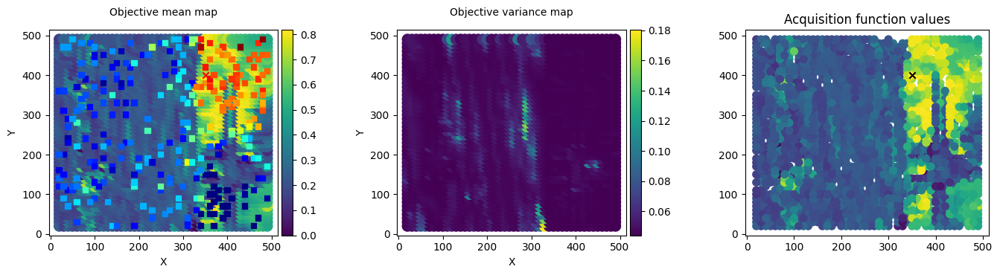

53/100


100%|██████████| 100/100 [00:14<00:00,  6.86it/s, init loss: 60417.1191, avg. loss [96-100]: 57015.6427]



Inferred GP kernel parameters
k_length         [3.7137 4.2128]
k_scale          0.16740000000000002
noise            0.04


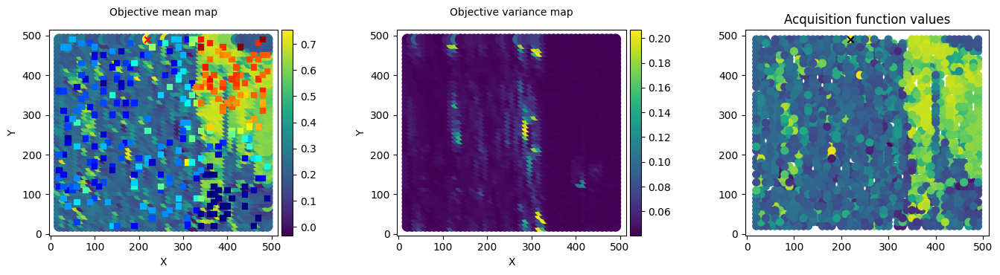

54/100


100%|██████████| 100/100 [00:19<00:00,  5.24it/s, init loss: 60418.4552, avg. loss [96-100]: 56977.8429]



Inferred GP kernel parameters
k_length         [5.4459 2.9143]
k_scale          0.1841
noise            0.037000000000000005


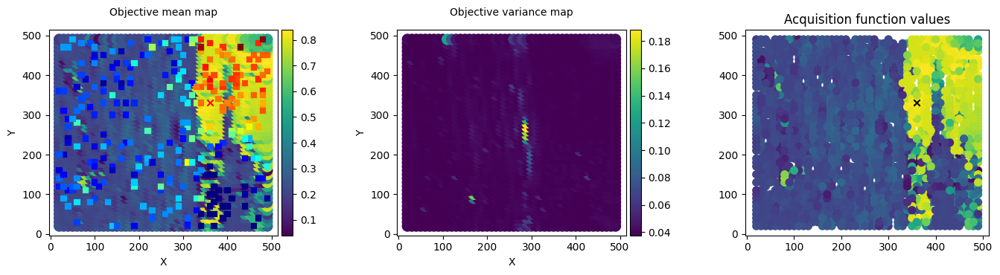

55/100


100%|██████████| 100/100 [00:21<00:00,  4.58it/s, init loss: 60419.5755, avg. loss [96-100]: 56945.5435]



Inferred GP kernel parameters
k_length         [5.9431 2.6279]
k_scale          0.1726
noise            0.032


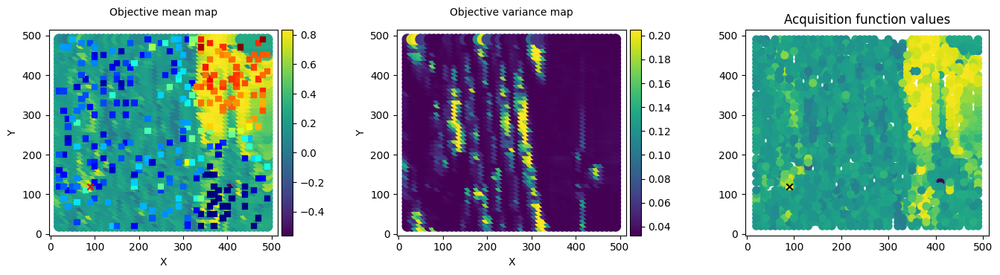

56/100


100%|██████████| 100/100 [00:21<00:00,  4.67it/s, init loss: 60420.9248, avg. loss [96-100]: 57003.9987]



Inferred GP kernel parameters
k_length         [3.6656 6.736 ]
k_scale          0.11810000000000001
noise            0.0386


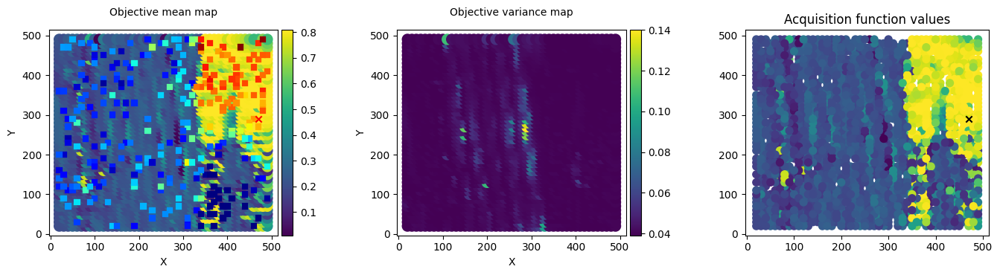

57/100


100%|██████████| 100/100 [00:16<00:00,  6.11it/s, init loss: 60422.0386, avg. loss [96-100]: 57051.2190]



Inferred GP kernel parameters
k_length         [4.5486 3.7809]
k_scale          0.12510000000000002
noise            0.0395


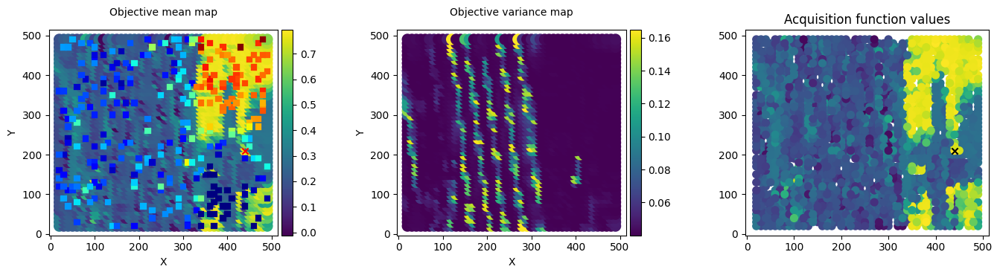

58/100


100%|██████████| 100/100 [00:19<00:00,  5.21it/s, init loss: 60423.1551, avg. loss [96-100]: 57033.7301]



Inferred GP kernel parameters
k_length         [5.1302 5.0543]
k_scale          0.1046
noise            0.0442


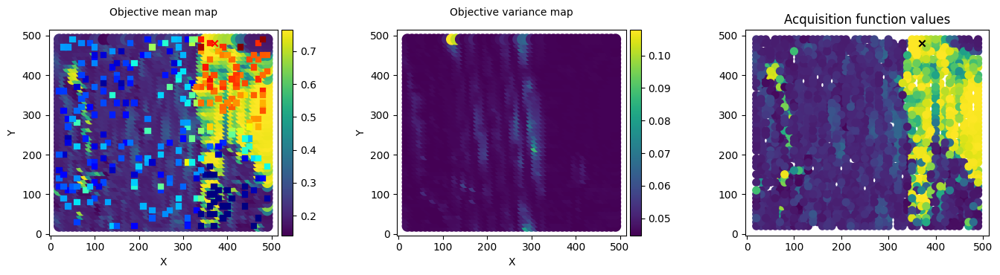

59/100


100%|██████████| 100/100 [00:21<00:00,  4.66it/s, init loss: 60424.2498, avg. loss [96-100]: 57021.1594]



Inferred GP kernel parameters
k_length         [4.5589 4.6194]
k_scale          0.1394
noise            0.0392


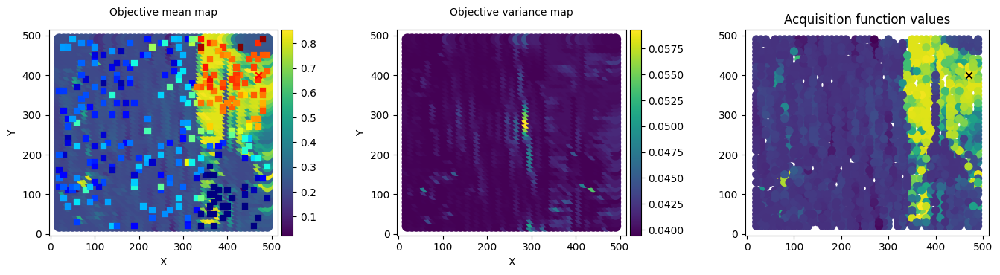

60/100


100%|██████████| 100/100 [00:14<00:00,  6.87it/s, init loss: 60425.3575, avg. loss [96-100]: 57003.8746]



Inferred GP kernel parameters
k_length         [5.1433 6.4424]
k_scale          0.14400000000000002
noise            0.0368


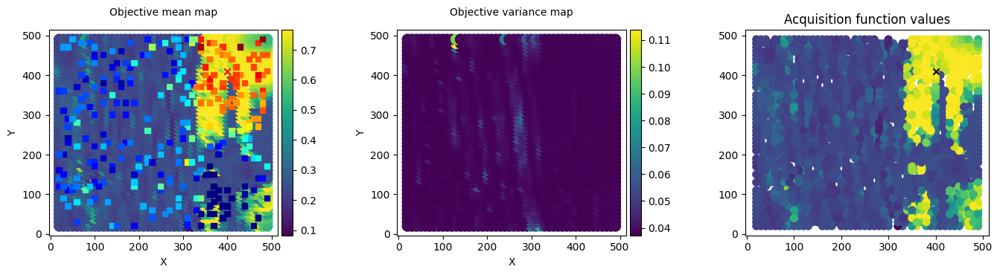

61/100


100%|██████████| 100/100 [00:20<00:00,  4.77it/s, init loss: 60426.5210, avg. loss [96-100]: 57031.7225]



Inferred GP kernel parameters
k_length         [4.4351 3.107 ]
k_scale          0.1618
noise            0.040600000000000004


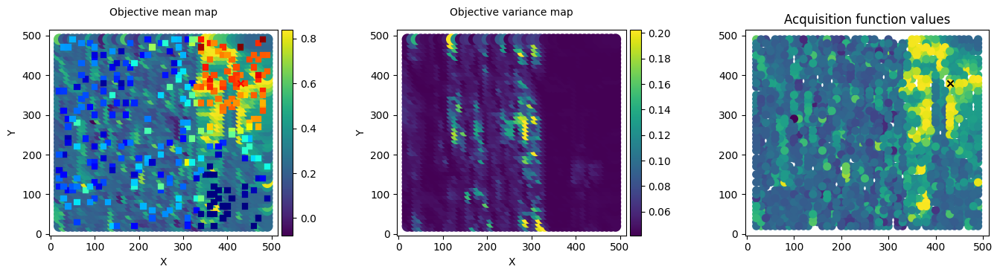

62/100


100%|██████████| 100/100 [00:13<00:00,  7.32it/s, init loss: 60427.6345, avg. loss [96-100]: 56963.0602]



Inferred GP kernel parameters
k_length         [3.5781 6.4604]
k_scale          0.1617
noise            0.0357


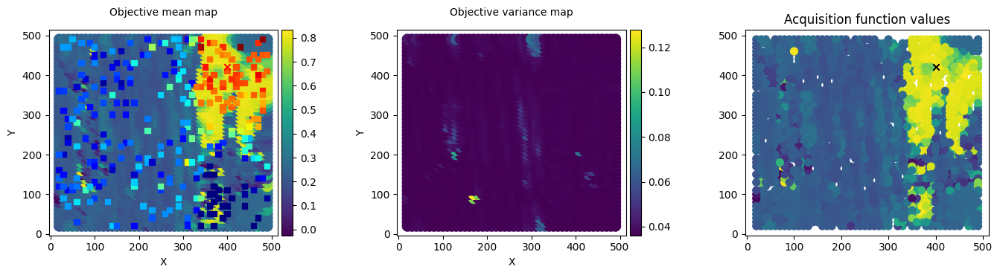

63/100


100%|██████████| 100/100 [00:25<00:00,  3.91it/s, init loss: 60428.9219, avg. loss [96-100]: 57000.3266]



Inferred GP kernel parameters
k_length         [3.3188 2.0326]
k_scale          0.1966
noise            0.0375


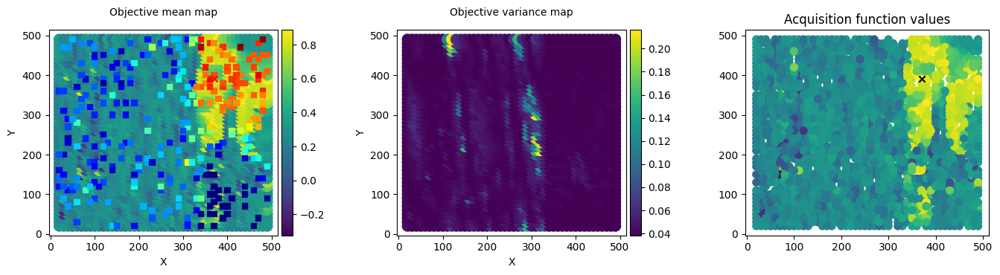

64/100


100%|██████████| 100/100 [00:16<00:00,  6.03it/s, init loss: 60430.0936, avg. loss [96-100]: 56977.2443]



Inferred GP kernel parameters
k_length         [3.3653 3.4443]
k_scale          0.1714
noise            0.040600000000000004


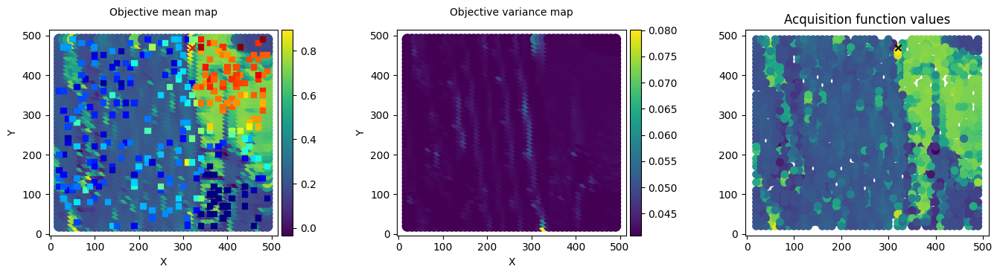

65/100


100%|██████████| 100/100 [00:21<00:00,  4.73it/s, init loss: 60431.4766, avg. loss [96-100]: 56992.0273]



Inferred GP kernel parameters
k_length         [6.8292 3.6714]
k_scale          0.09290000000000001
noise            0.0425


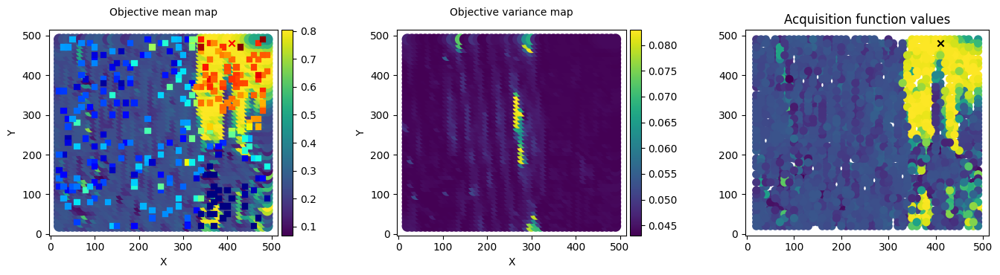

66/100


100%|██████████| 100/100 [00:19<00:00,  5.15it/s, init loss: 60432.5647, avg. loss [96-100]: 57129.1905]



Inferred GP kernel parameters
k_length         [2.7717 2.3199]
k_scale          0.1652
noise            0.039


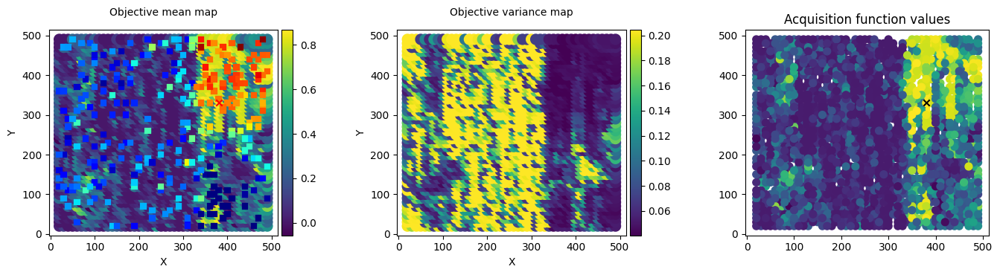

67/100


100%|██████████| 100/100 [00:19<00:00,  5.02it/s, init loss: 60433.6530, avg. loss [96-100]: 57005.3353]



Inferred GP kernel parameters
k_length         [4.3889 5.501 ]
k_scale          0.16690000000000002
noise            0.0403


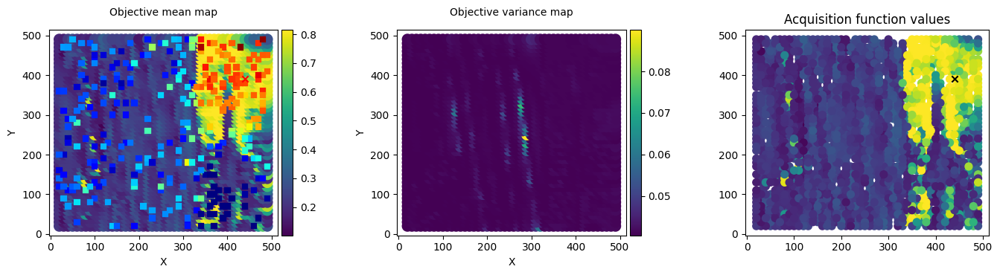

68/100


100%|██████████| 100/100 [00:22<00:00,  4.47it/s, init loss: 60434.7471, avg. loss [96-100]: 57000.3087]



Inferred GP kernel parameters
k_length         [5.9965 3.3759]
k_scale          0.1567
noise            0.037000000000000005


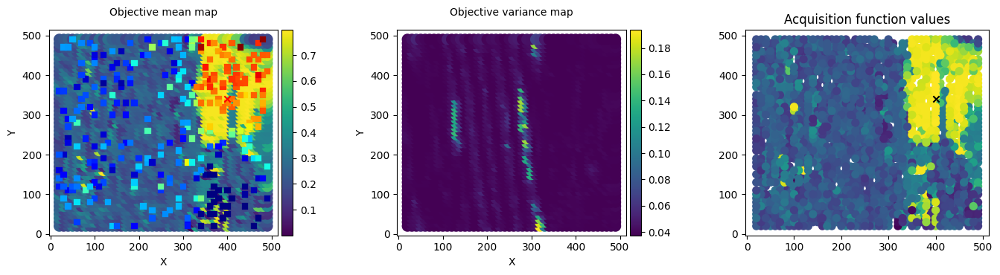

69/100


100%|██████████| 100/100 [00:14<00:00,  6.97it/s, init loss: 60435.8793, avg. loss [96-100]: 56995.0109]



Inferred GP kernel parameters
k_length         [4.6363 2.9706]
k_scale          0.1356
noise            0.0385


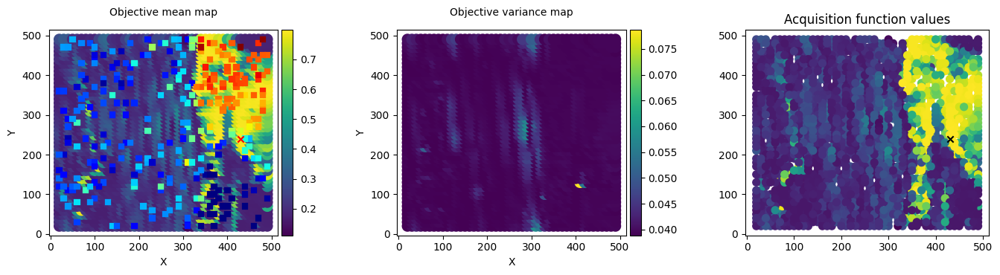

70/100


100%|██████████| 100/100 [00:25<00:00,  3.92it/s, init loss: 60437.1437, avg. loss [96-100]: 56992.4723]



Inferred GP kernel parameters
k_length         [5.687  6.8138]
k_scale          0.1228
noise            0.0367


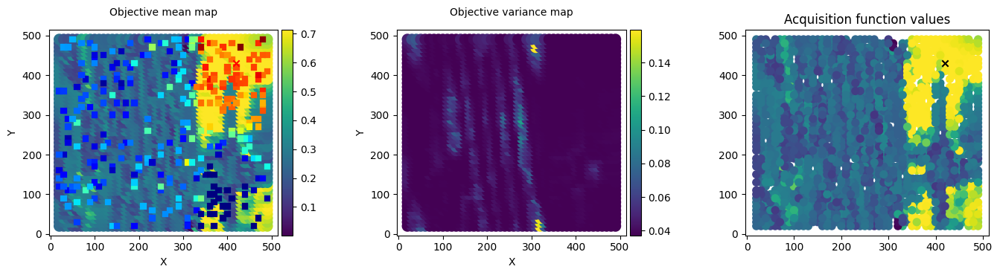

71/100


100%|██████████| 100/100 [00:22<00:00,  4.51it/s, init loss: 60438.2339, avg. loss [96-100]: 57006.7458]



Inferred GP kernel parameters
k_length         [5.1287 3.4888]
k_scale          0.15360000000000001
noise            0.0381


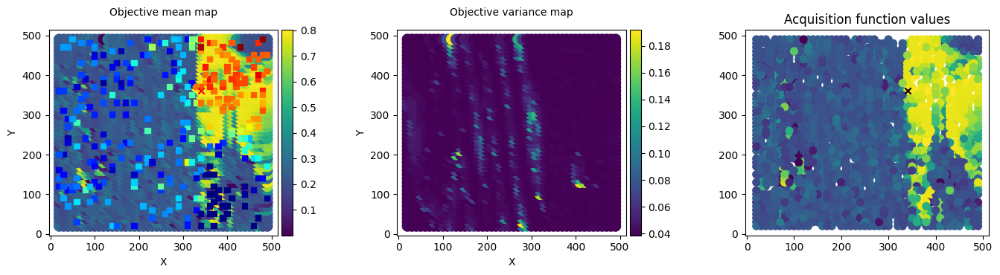

72/100


100%|██████████| 100/100 [00:18<00:00,  5.43it/s, init loss: 60439.3349, avg. loss [96-100]: 57089.6643]



Inferred GP kernel parameters
k_length         [4.0114 3.4504]
k_scale          0.10450000000000001
noise            0.041


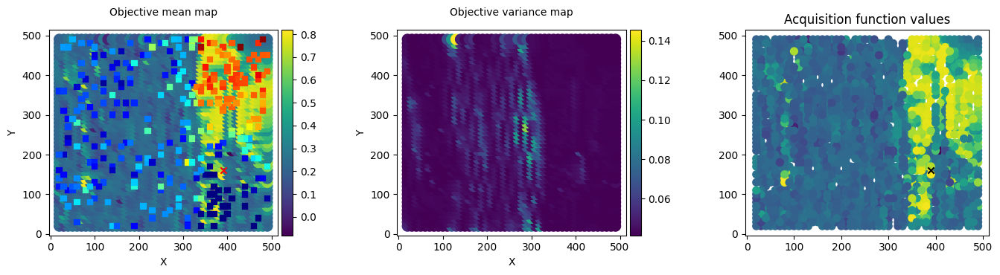

73/100


100%|██████████| 100/100 [00:20<00:00,  4.90it/s, init loss: 60440.5930, avg. loss [96-100]: 56992.6481]



Inferred GP kernel parameters
k_length         [3.7392 6.744 ]
k_scale          0.1529
noise            0.0395


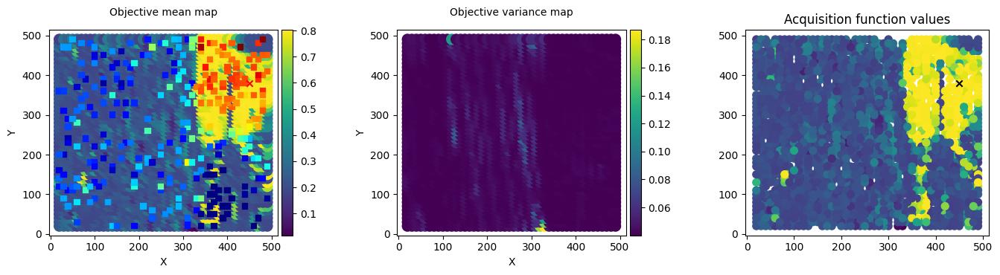

74/100


100%|██████████| 100/100 [00:21<00:00,  4.55it/s, init loss: 60441.6810, avg. loss [96-100]: 57153.3379]



Inferred GP kernel parameters
k_length         [4.9422 3.4116]
k_scale          0.1442
noise            0.0373


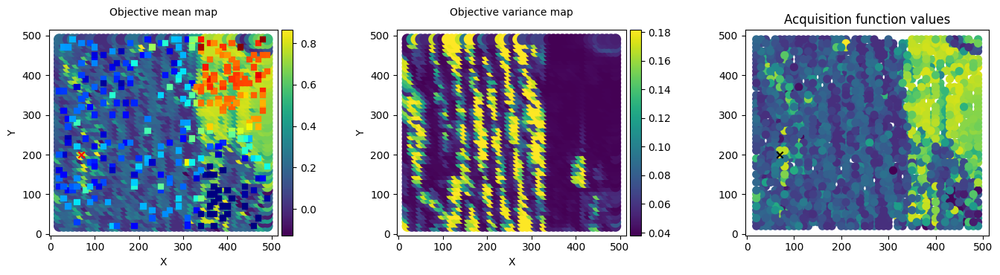

75/100


100%|██████████| 100/100 [00:29<00:00,  3.36it/s, init loss: 60443.0196, avg. loss [96-100]: 57039.9667]



Inferred GP kernel parameters
k_length         [4.125  3.7964]
k_scale          0.10590000000000001
noise            0.041


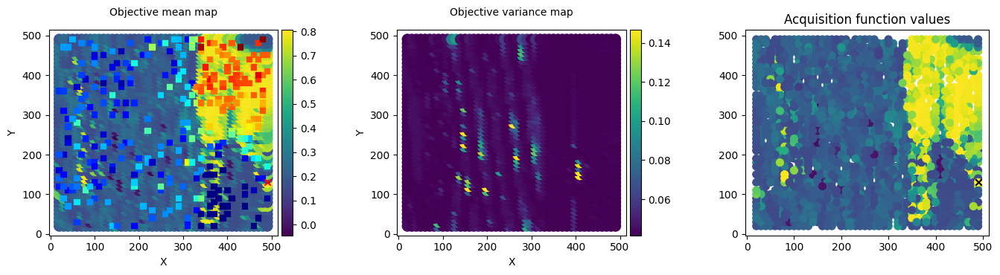

76/100


100%|██████████| 100/100 [00:26<00:00,  3.84it/s, init loss: 60444.2477, avg. loss [96-100]: 57103.0607]



Inferred GP kernel parameters
k_length         [5.2207 6.3797]
k_scale          0.0952
noise            0.041


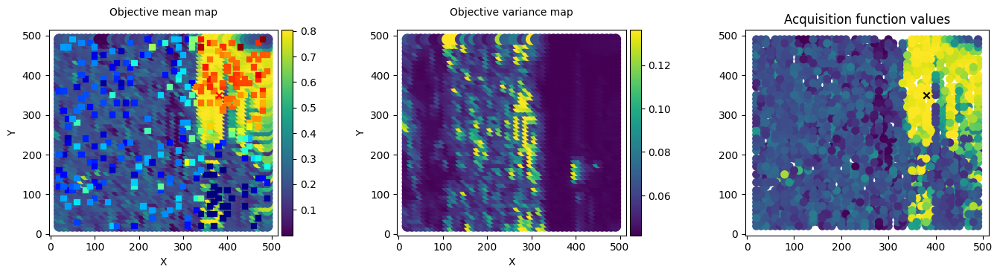

77/100


100%|██████████| 100/100 [00:29<00:00,  3.34it/s, init loss: 60445.3427, avg. loss [96-100]: 57098.0209]



Inferred GP kernel parameters
k_length         [3.1358 2.9656]
k_scale          0.1255
noise            0.0373


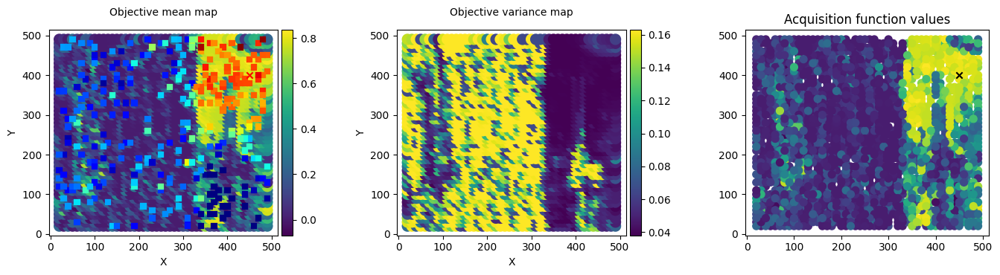

78/100


100%|██████████| 100/100 [00:26<00:00,  3.73it/s, init loss: 60446.4458, avg. loss [96-100]: 56919.2767]



Inferred GP kernel parameters
k_length         [7.1341 3.1245]
k_scale          0.1492
noise            0.032100000000000004


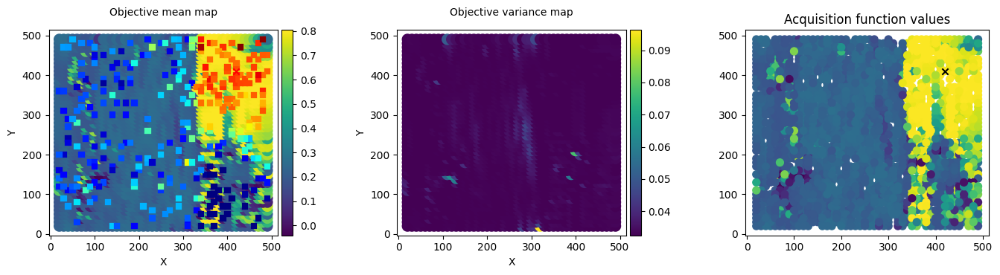

79/100


100%|██████████| 100/100 [00:25<00:00,  3.98it/s, init loss: 60447.5306, avg. loss [96-100]: 56937.9299]



Inferred GP kernel parameters
k_length         [5.3095 3.5837]
k_scale          0.1399
noise            0.034300000000000004


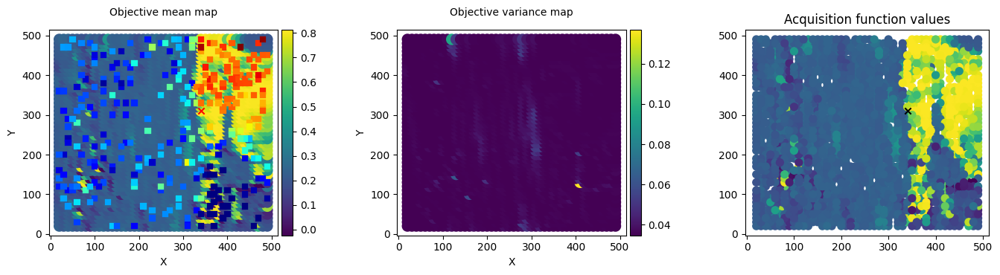

80/100


100%|██████████| 100/100 [00:24<00:00,  4.10it/s, init loss: 60448.6300, avg. loss [96-100]: 56997.1499]



Inferred GP kernel parameters
k_length         [4.3319 6.2971]
k_scale          0.14650000000000002
noise            0.0422


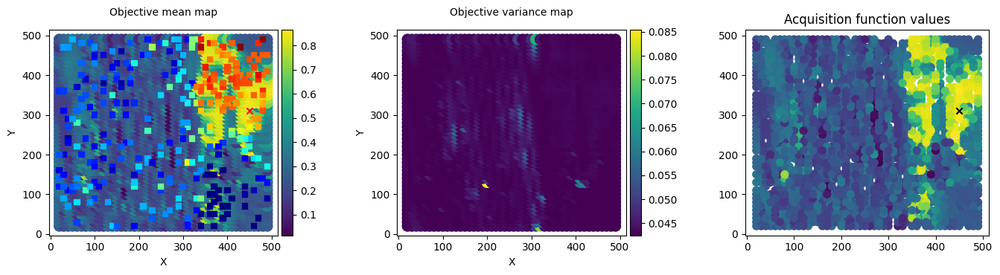

81/100


100%|██████████| 100/100 [00:32<00:00,  3.10it/s, init loss: 60449.7470, avg. loss [96-100]: 56961.0856]



Inferred GP kernel parameters
k_length         [3.6714 4.7034]
k_scale          0.1643
noise            0.0373


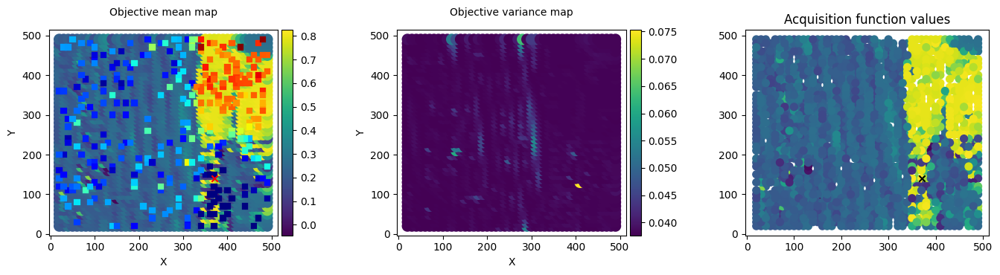

82/100


100%|██████████| 100/100 [00:25<00:00,  3.96it/s, init loss: 60450.9543, avg. loss [96-100]: 56937.4595]



Inferred GP kernel parameters
k_length         [3.9118 3.3724]
k_scale          0.185
noise            0.032600000000000004


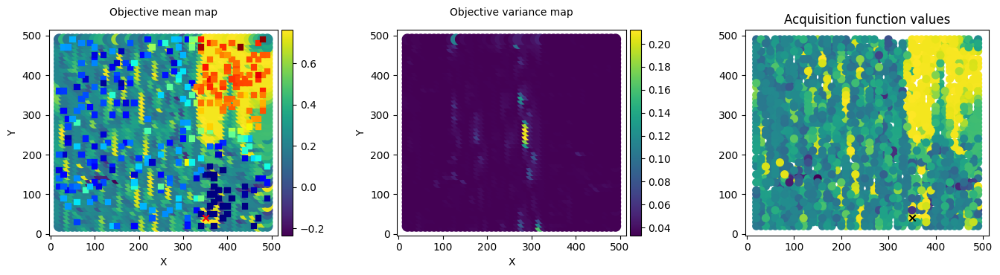

83/100


100%|██████████| 100/100 [00:24<00:00,  4.14it/s, init loss: 60452.2088, avg. loss [96-100]: 57014.4862]



Inferred GP kernel parameters
k_length         [3.5973 4.1083]
k_scale          0.1048
noise            0.0381


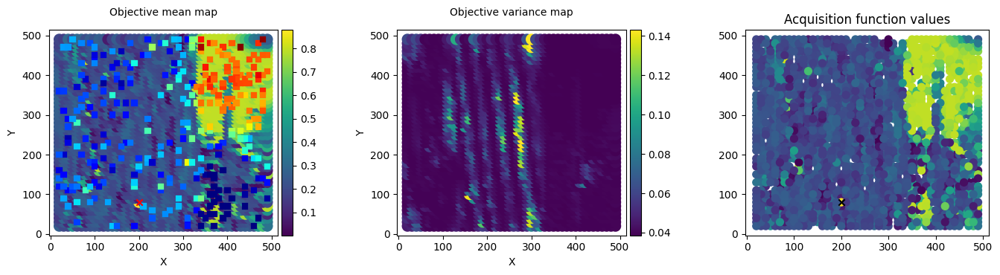

84/100


100%|██████████| 100/100 [00:25<00:00,  3.85it/s, init loss: 60453.4253, avg. loss [96-100]: 57045.9979]



Inferred GP kernel parameters
k_length         [4.7516 4.3875]
k_scale          0.0969
noise            0.0356


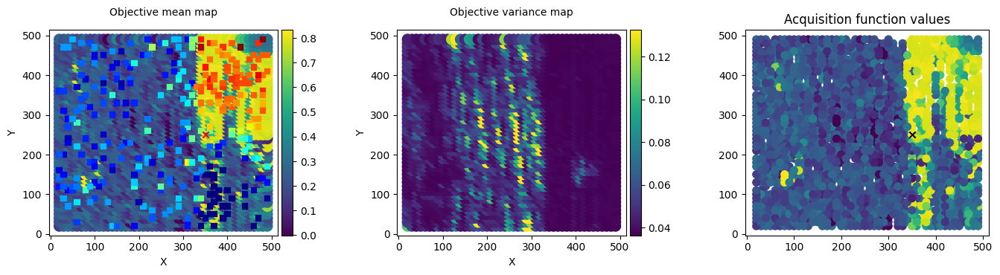

85/100


100%|██████████| 100/100 [00:11<00:00,  8.85it/s, init loss: 60454.5540, avg. loss [96-100]: 56972.7758]



Inferred GP kernel parameters
k_length         [5.507  3.2916]
k_scale          0.1279
noise            0.034800000000000005


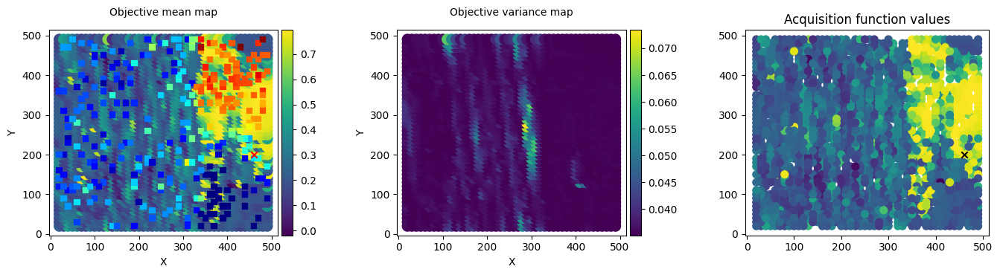

86/100


100%|██████████| 100/100 [00:11<00:00,  9.01it/s, init loss: 60455.6988, avg. loss [96-100]: 57006.5325]



Inferred GP kernel parameters
k_length         [2.6002 4.3966]
k_scale          0.1497
noise            0.0362


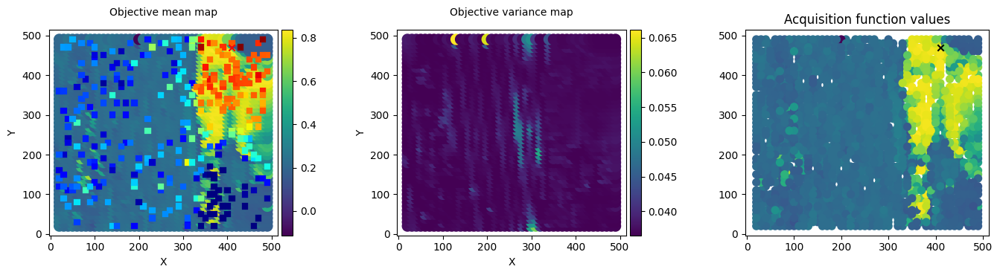

87/100


100%|██████████| 100/100 [00:12<00:00,  8.00it/s, init loss: 60456.8538, avg. loss [96-100]: 57277.1251]



Inferred GP kernel parameters
k_length         [7.9334 4.5391]
k_scale          0.10600000000000001
noise            0.0375


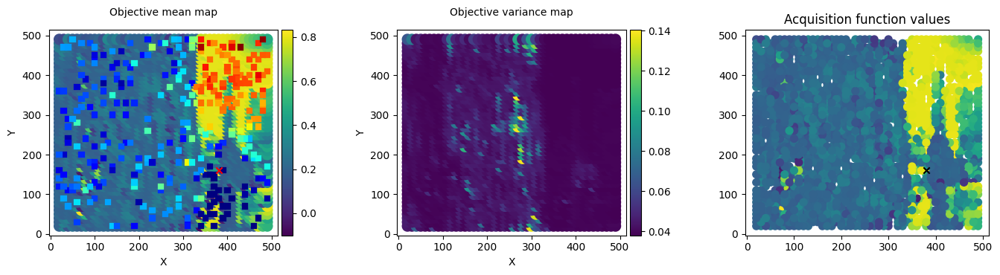

88/100


100%|██████████| 100/100 [00:10<00:00,  9.73it/s, init loss: 60458.1046, avg. loss [96-100]: 57129.7277]



Inferred GP kernel parameters
k_length         [6.3533 6.3337]
k_scale          0.161
noise            0.040100000000000004


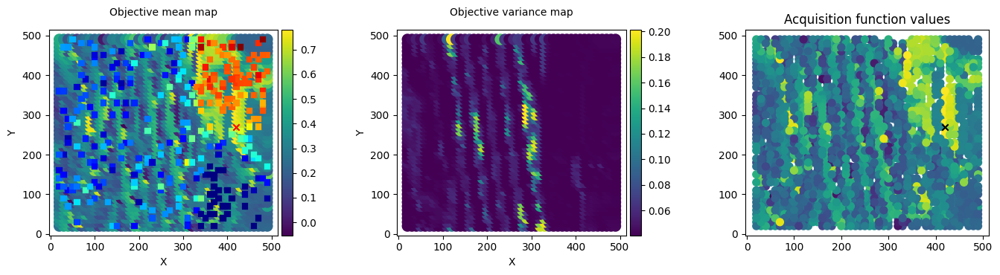

89/100


100%|██████████| 100/100 [00:25<00:00,  3.98it/s, init loss: 60459.1890, avg. loss [96-100]: 56974.4016]



Inferred GP kernel parameters
k_length         [3.7975 3.6707]
k_scale          0.1416
noise            0.0379


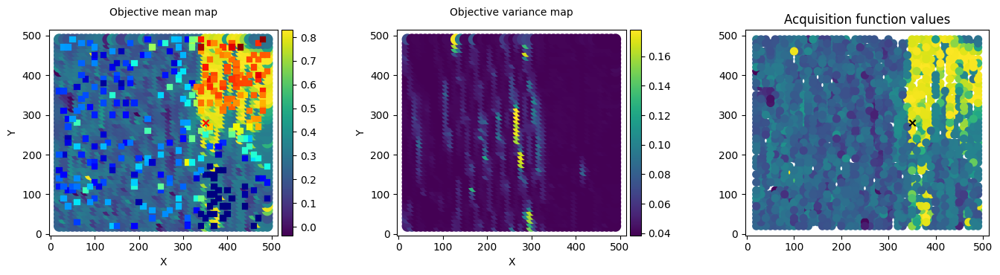

90/100


100%|██████████| 100/100 [00:18<00:00,  5.54it/s, init loss: 60460.3169, avg. loss [96-100]: 57078.2759]



Inferred GP kernel parameters
k_length         [6.5726 7.2554]
k_scale          0.12610000000000002
noise            0.043000000000000003


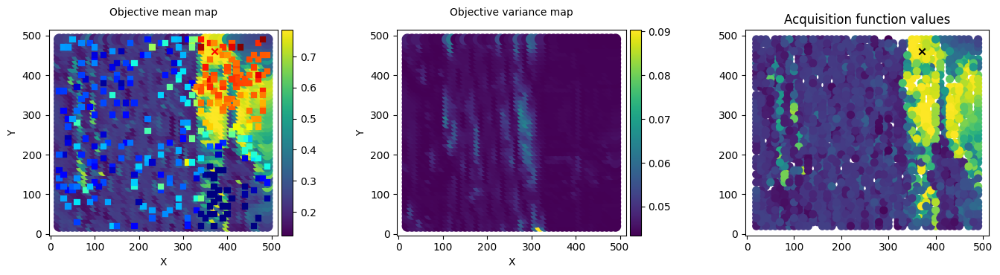

91/100


100%|██████████| 100/100 [00:26<00:00,  3.74it/s, init loss: 60461.4080, avg. loss [96-100]: 56974.1869]



Inferred GP kernel parameters
k_length         [2.6805 3.8651]
k_scale          0.1898
noise            0.0369


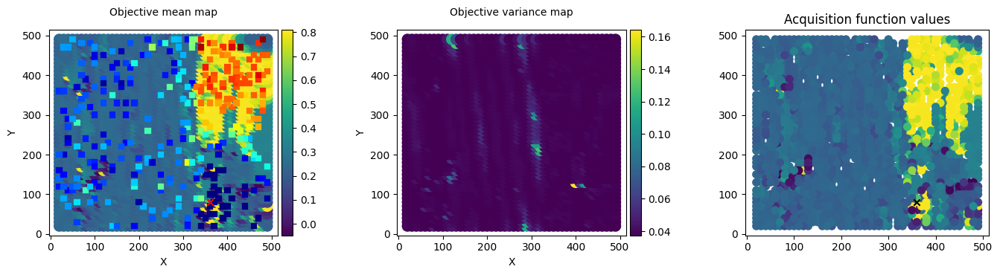

92/100


100%|██████████| 100/100 [00:22<00:00,  4.48it/s, init loss: 60462.6411, avg. loss [96-100]: 57029.9872]



Inferred GP kernel parameters
k_length         [6.0495 4.7806]
k_scale          0.1254
noise            0.0391


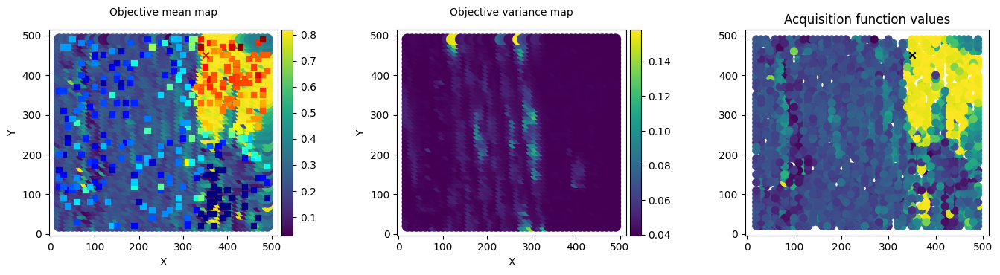

93/100


100%|██████████| 100/100 [00:26<00:00,  3.78it/s, init loss: 60463.7485, avg. loss [96-100]: 57098.4102]



Inferred GP kernel parameters
k_length         [6.3879 4.8526]
k_scale          0.1182
noise            0.035


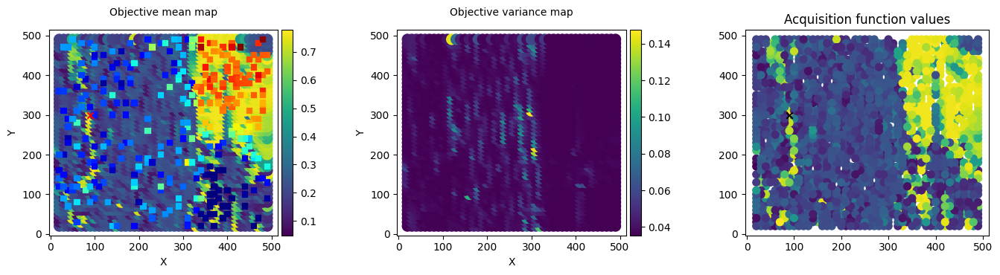

94/100


100%|██████████| 100/100 [00:31<00:00,  3.18it/s, init loss: 60465.0161, avg. loss [96-100]: 56954.8748]



Inferred GP kernel parameters
k_length         [4.9972 3.7997]
k_scale          0.1444
noise            0.0322


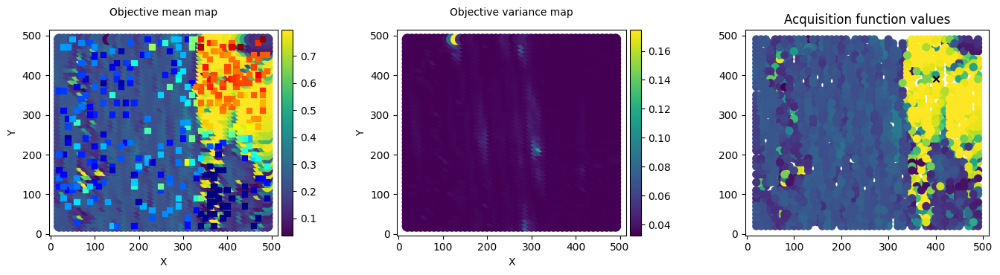

95/100


100%|██████████| 100/100 [00:23<00:00,  4.19it/s, init loss: 60466.2173, avg. loss [96-100]: 57014.7291]



Inferred GP kernel parameters
k_length         [5.1945 7.1695]
k_scale          0.1159
noise            0.040600000000000004


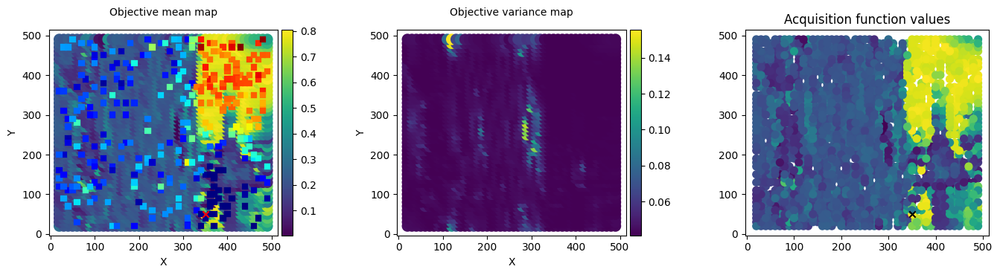

96/100


100%|██████████| 100/100 [00:29<00:00,  3.41it/s, init loss: 60467.3958, avg. loss [96-100]: 56996.4549]



Inferred GP kernel parameters
k_length         [3.5959 4.4074]
k_scale          0.1512
noise            0.0381


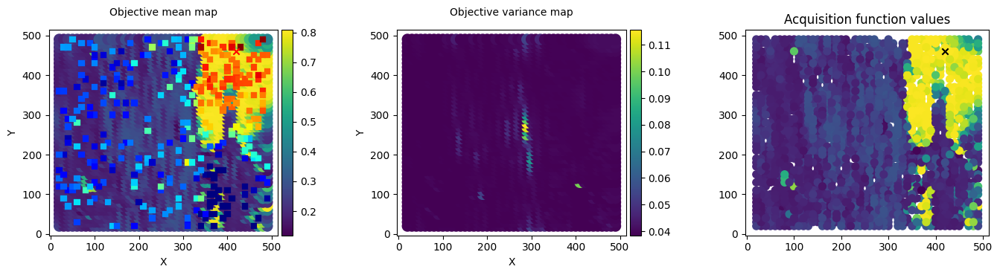

97/100


100%|██████████| 100/100 [00:22<00:00,  4.41it/s, init loss: 60468.7650, avg. loss [96-100]: 56990.9233]



Inferred GP kernel parameters
k_length         [2.999  3.2696]
k_scale          0.19060000000000002
noise            0.0347


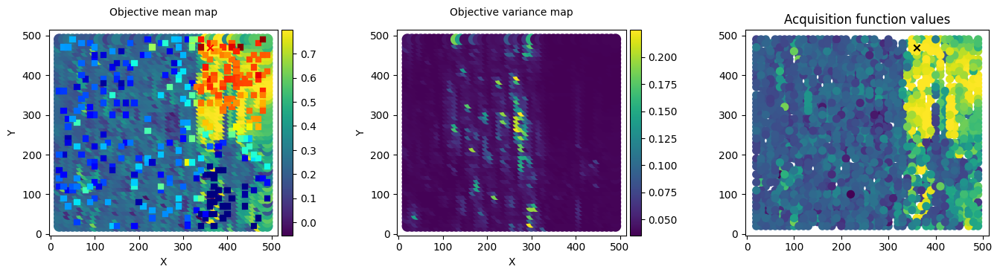

98/100


100%|██████████| 100/100 [00:27<00:00,  3.64it/s, init loss: 60469.8589, avg. loss [96-100]: 56980.5061]



Inferred GP kernel parameters
k_length         [3.7901 6.9453]
k_scale          0.1495
noise            0.031200000000000002


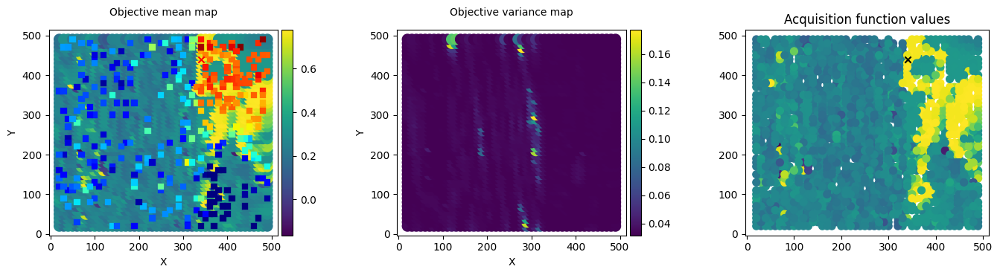

99/100


100%|██████████| 100/100 [00:33<00:00,  3.03it/s, init loss: 60470.9538, avg. loss [96-100]: 57134.0364]



Inferred GP kernel parameters
k_length         [4.6189 6.5831]
k_scale          0.1051
noise            0.0375


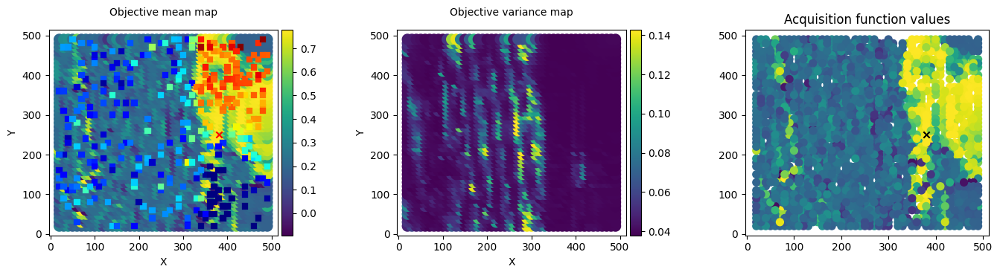

100/100


100%|██████████| 100/100 [00:24<00:00,  4.09it/s, init loss: 60472.1779, avg. loss [96-100]: 57002.1159]



Inferred GP kernel parameters
k_length         [5.8308 3.6782]
k_scale          0.10020000000000001
noise            0.0363


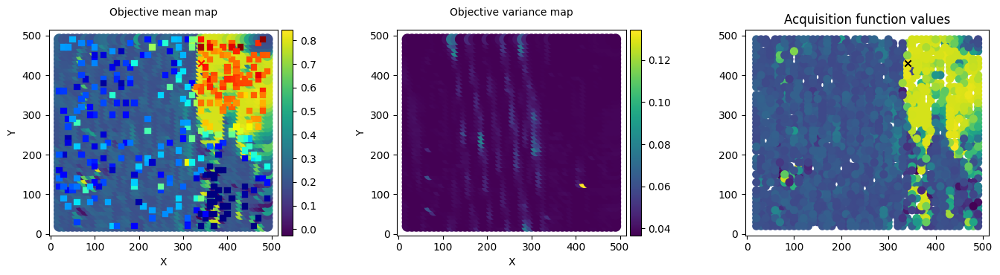

In [63]:
# DKL Implementation - Active learning

exploration_steps = 100


for e in range(exploration_steps):

    print("{}/{}".format(e+1, exploration_steps))

    key1, key2 = gpax.utils.get_keys()
    data_dim = X_train.shape[-1]

    #Normalize train output
    y_train_norm = normalize_0to1(y_train)

    #Train model
    dkl = gpax.viDKL(data_dim, 2, kernel = 'RBF')

    dkl.fit(key1, X_train, y_train_norm, num_steps=100, step_size=0.05)

    # Compute UCB acquisition function with beta annealed in range 10 - 0.001

    power_f = (len(y_train) - initial_train)
    if power_f < 1:
        power_f = 0

    beta_iter = 10 * (0.9**(power_f))

    if beta_iter < 0.001:
        beta_iter = 0.001

    obj = gpax.acquisition.UCB(key2, dkl, X_test, beta=beta_iter, maximize=True)   # you may decrease step size and increase number of steps (e.g. to 0.005 and 1000) for more stable performance

    # DKL prediction
    mean, var = dkl.predict(key2, X)

    # Select next point to "measure"
    next_point_idx = obj.argmax()
    next_point = indices_test[next_point_idx]   # coordinate of the points

    # Do "measurement" - based on ground truth data
    measured_point = y_test[next_point_idx]

    # Plot current result
    plot_DKL_prediction(mean, var, obj, indices_test, indices_train, y_train)

    # Update train and test sets

    X_train = np.append(X_train, np.asarray([X_test[next_point_idx]]), axis = 0)
    X_test = np.delete(X_test, next_point_idx, 0)

    y_train = np.append(y_train, measured_point)
    y_test = np.delete(y_test, next_point_idx)

    indices_train = np.append(indices_train, np.asarray([next_point]), 0)
    indices_test = np.delete(indices_test, next_point_idx, 0)

Save the data

In [64]:
frame = 250 # framesize of the sample, 250 nm

save_arr = np.array([indices_train[:,1], indices_train[:,0], y_train])
np.savetxt("save_dkl_compilation.txt", save_arr.T, delimiter='\t')

# Analyze DKL prediction

DKL prediction

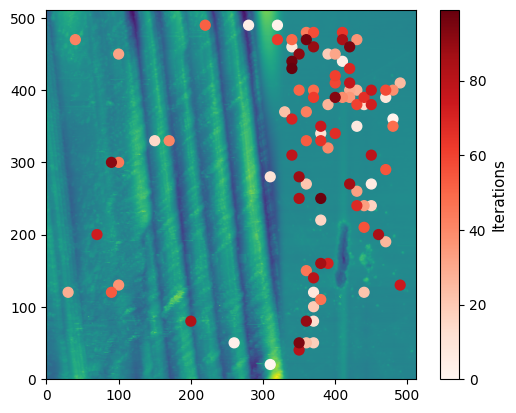

In [65]:
plt.imshow(ds_image, origin = 'lower')
plt.scatter(indices_train[initial_train:, 1], indices_train[initial_train:, 0], c=np.arange(len(indices_train[initial_train:])), s=50, cmap="Reds")
cbar = plt.colorbar()
cbar.set_label(r"Iterations", size = 11)
plt.show()


DKL scalar map

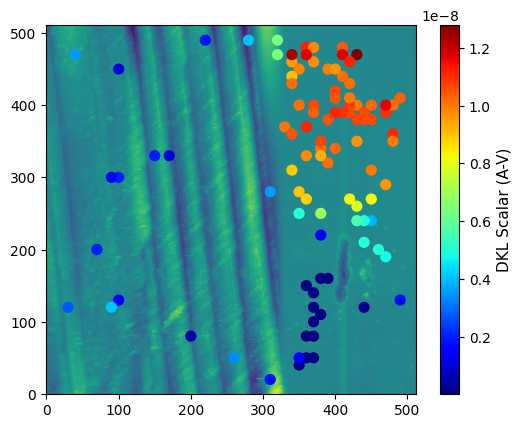

In [66]:
plt.imshow(ds_image, origin = 'lower')
plt.scatter(indices_train[initial_train:, 1], indices_train[initial_train:, 0], c=y_train[initial_train:], s=50, cmap="jet")
cbar = plt.colorbar()
cbar.set_label(r"DKL Scalar (A-V)", size = 11)
plt.show()

# Implementation of Multiscale DKL


Multiscale DKL uses the above described procedure at multiple length scales, buy iteratively narrowing to sample locations of smaller dimentions.

The next frame of sample location is chosen based on the output of the function: "next_scan_coordWeight"


In [67]:
!git clone https://github.com/gnganesh99/DKL_on_STM.git



fatal: destination path 'DKL_on_STM' already exists and is not an empty directory.


In [68]:
import sys
sys.path.append('DKL_on_STM')

from next_DKL_coordinate import next_scan_coordWeight


# Choose the scan_frame related for the next DKL implmentation
frame_new = 50 # frame_new < frame



In [69]:
# Get the next center coordinate of the scan_frame
x_next, y_next = next_scan_coordWeight('save_dkl_compilation.txt', pixels, frame, frame_new)
print(x_next, y_next)

frame_pixels = int(frame_new/frame*pixels)
x_next_px, y_next_px = int(x_next/frame*pixels), int(y_next/frame*pixels)



190.4296875 205.078125


Plot next chosen area on the sample region

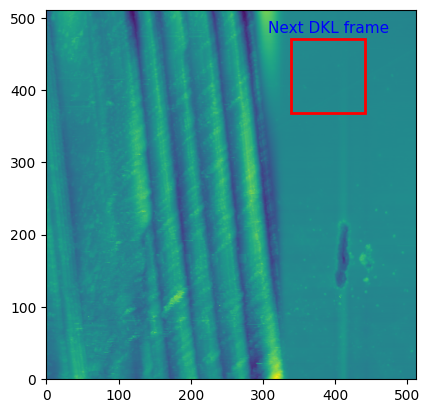

In [70]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Create figure and axes
fig, ax = plt.subplots()

ax.imshow(ds_image, origin='lower')

# Create a rectangle of the next scan frame
rectangle = patches.Rectangle((x_next_px-frame_pixels/2, y_next_px-frame_pixels/2), frame_pixels, frame_pixels, linewidth=2, edgecolor='r', facecolor='none')

ax.add_patch(rectangle)

text_x = x_next_px + frame_pixels/2 -50
text_y = y_next_px + frame_pixels/2+5
ax.text(text_x, text_y, "Next DKL frame", ha='center', va='bottom', fontsize=11, color='blue')


plt.show()
